In [1]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
%matplotlib inline
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

## 데이터셋 load

In [7]:
import os

# 현재 경로 확인
current_path = os.getcwd()
print(f"Current working directory: {current_path}")

Current working directory: C:\Users\dongwon\OneDrive - seoultech.ac.kr\바탕 화면\jupyter notebook\스마트팜\dinomaly


In [183]:
from torch.utils.data import random_split
from torchvision.transforms import v2

img_path = 'C:\\Users\\dongwon\\OneDrive - seoultech.ac.kr\\바탕 화면\\jupyter notebook\\스마트팜\\dinomaly\\data\\bottle\\train/'


transforma = transforms.Compose([
    v2.Resize((256,256), interpolation = transforms.InterpolationMode.BICUBIC),
    v2.CenterCrop(224),
    v2.ToImage(), v2.ToDtype(torch.float32, scale=True),
])

transform_dataset = datasets.ImageFolder(root=img_path, transform=transforma)

test_path = 'C:\\Users\\dongwon\\OneDrive - seoultech.ac.kr\\바탕 화면\\jupyter notebook\\스마트팜\\dinomaly\\data\\bottle\\test/'

transformss = transforms.Compose([
    v2.Resize((256,256), interpolation = transforms.InterpolationMode.BICUBIC),
    v2.CenterCrop(224),
    v2.ToImage(), v2.ToDtype(torch.float32, scale=True),
])
test_dataset = datasets.ImageFolder(root=test_path, transform=transformss)

trainloader = DataLoader(transform_dataset, batch_size=64, shuffle=True, num_workers=2)
testloader = DataLoader(test_dataset, batch_size=64, shuffle=True)

In [23]:
test_dataset.classes

['broken_large', 'broken_small', 'contamination', 'good']

### train, test 데이터 셋 확인

In [25]:
#Utility functions to un-normalize and display an image
def imshow(img):
    img = img / 2 + 0.5
    plt.imshow(np.transpose(img, (1, 2, 0)))

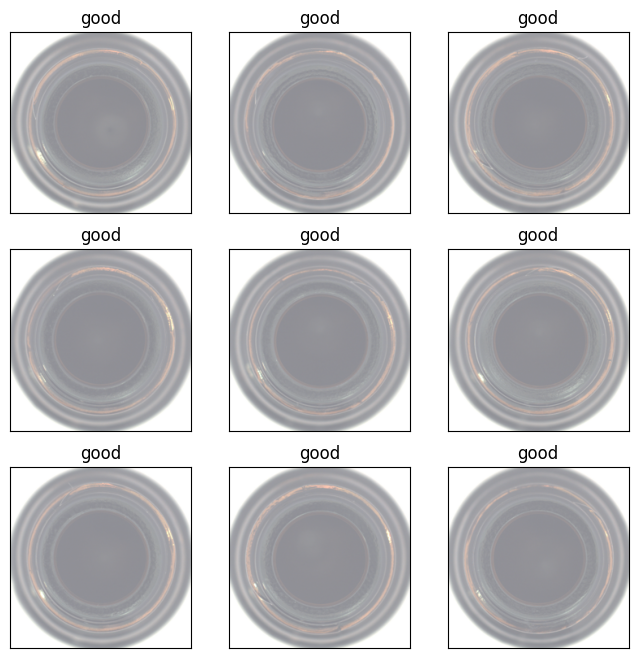

In [27]:
# 이미지를 un-normalize하고 display하는 함수
def imshow(img):
    img = img / 2 + 0.5  # 정규화된 이미지를 되돌림
    plt.imshow(np.transpose(img, (1, 2, 0)))  # 채널, 높이, 너비 순에서 높이, 너비, 채널 순으로 변환

# 데이터셋에서 클래스 정보 가져오기
classes = transform_dataset.classes

# 하나의 배치에서 9개의 이미지와 라벨을 가져옵니다
dataiter = iter(trainloader)
images, labels = next(dataiter)

# 이미지를 numpy로 변환
images = images.numpy()

# 이미지를 시각화하는 코드
fig = plt.figure(figsize=(8, 8))  # 8x8 사이즈로 플로팅
for idx in np.arange(9):  # 첫 9개 이미지를 출력
    ax = fig.add_subplot(3, 3, idx + 1, xticks=[], yticks=[])  # 3x3 그리드
    imshow(images[idx])  # (채널, 높이, 너비) -> (높이, 너비, 채널) 순으로 변환
    ax.set_title(classes[labels[idx]])  # 클래스 이름을 제목으로 설정

plt.show()  # 시각화된 이미지 출력


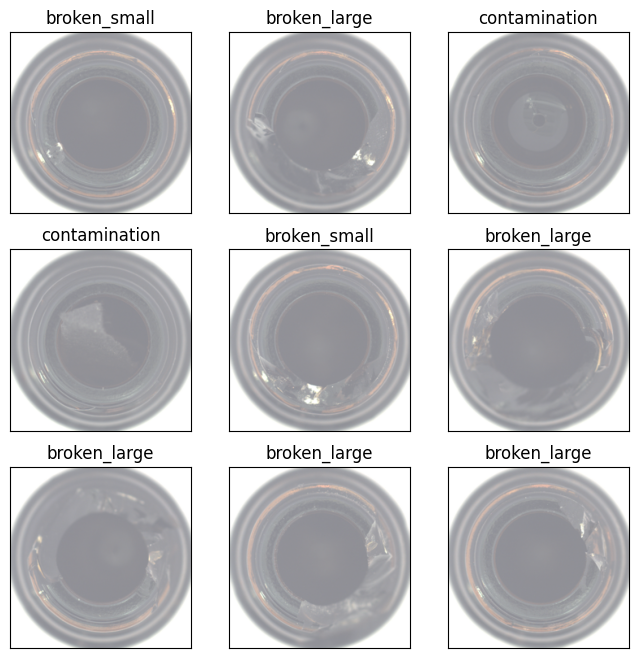

In [28]:
# 이미지를 un-normalize하고 display하는 함수
def imshow(img):
    img = img / 2 + 0.5  # 정규화된 이미지를 되돌림
    plt.imshow(np.transpose(img, (1, 2, 0)))  # 채널, 높이, 너비 순에서 높이, 너비, 채널 순으로 변환

# 데이터셋에서 클래스 정보 가져오기
classes = test_dataset.classes

# 하나의 배치에서 9개의 이미지와 라벨을 가져옵니다
dataiter = iter(testloader)
images, labels = next(dataiter)

# 이미지를 numpy로 변환
images = images.numpy()

# 이미지를 시각화하는 코드
fig = plt.figure(figsize=(8, 8))  # 8x8 사이즈로 플로팅
for idx in np.arange(9):  # 첫 9개 이미지를 출력
    ax = fig.add_subplot(3, 3, idx + 1, xticks=[], yticks=[])  # 3x3 그리드
    imshow(images[idx])  # (채널, 높이, 너비) -> (높이, 너비, 채널) 순으로 변환
    ax.set_title(classes[labels[idx]])  # 클래스 이름을 제목으로 설정

plt.show()  # 시각화된 이미지 출력


## model 구성

### checkpoint 저장함수

In [36]:
def save_checkpoint(model, optimizer, epoch, loss, filename='checkpoint2.pth'):
    checkpoint = {
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss,
    }
    torch.save(checkpoint, filename)
    print(f"Checkpoint saved at epoch {epoch}")

In [215]:
# VGG Encoder 정의
class VGGEncoder(nn.Module):
    def __init__(self):
        super(VGGEncoder, self).__init__()
        vgg = models.vgg16(pretrained=True)
        self.encoder = vgg.features  # VGG16의 features 부분 사용
        for param in self.encoder.parameters():
            param.requires_grad = False  # 가중치 업데이트 안 되도록 설정

    def forward(self, x):
        feature_maps = []  # 각 Conv 레이어의 feature map 저장
        for layer in self.encoder:
            x = layer(x)
            if isinstance(layer, nn.Conv2d):  # Conv 레이어일 경우만 저장
                feature_maps.append(x)
        return feature_maps

# Decoder 정의
class ReconstructionDecoder(nn.Module):
    def __init__(self):
        super(ReconstructionDecoder, self).__init__()
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()  # 0~1 범위로 정규화
        )

    def forward(self, x):
        return self.decoder(x)

# ReconstructionModel: VGGEncoder와 ReconstructionDecoder를 결합
class ReconstructionModel(nn.Module):
    def __init__(self):
        super(ReconstructionModel, self).__init__()
        self.encoder = VGGEncoder()
        self.decoder = ReconstructionDecoder()

    def forward(self, x):
        feature_maps = self.encoder(x)  # Encoder로부터 feature map 얻기
        encoded = feature_maps[-1]     # 마지막 feature map 사용
        reconstructed = self.decoder(encoded)
        return reconstructed, feature_maps  # 재구성된 이미지와 feature map을 반환

# 이상 탐지 기준: MSE Loss
class AnomalyDetectionModel(nn.Module):
    def __init__(self):
        super(AnomalyDetectionModel, self).__init__()
        self.reconstruction_model = ReconstructionModel()

    def forward(self, x):
        reconstructed, _ = self.reconstruction_model(x)
        return reconstructed

    def calculate_loss(self, x, reconstructed):
        # MSE Loss로 재구성 손실 계산
        loss = nn.MSELoss()(reconstructed, x)
        return loss

# 학습 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = AnomalyDetectionModel().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 데이터 로더 설정 (예시: trainloader, testloader)
# trainloader, testloader는 데이터셋과 배치 크기에 맞게 설정

def save_images_to_list(inputs, reconstructed):
    """
    입력과 재구성된 이미지를 리스트에 저장하여 반환
    """
    inputs = inputs.detach().cpu()  # GPU -> CPU로 이동
    reconstructed = reconstructed.detach().cpu()
    images = []
    
    for i in range(min(8, inputs.size(0))):  # 최대 8개 이미지만 저장
        images.append((inputs[i].squeeze(), reconstructed[i].squeeze()))
    
    return images

# 학습 루프
def train_model(model, dataloader, optimizer, num_epochs=10, checkpoint_path='C:\\Users\\dongwon\\OneDrive - seoultech.ac.kr\\바탕 화면\\jupyter notebook\\스마트팜\\dinomaly\\base_model_checkpoint\\', start_epoch=None):
    model.train()
    epoch_images =[]
    start_epoch = start_epoch
    for epoch in range(num_epochs):
        start_epoch += 1
        running_loss = 0.0
        with tqdm(enumerate(dataloader), total=len(dataloader), desc=f"Epoch {epoch + 1}/{num_epochs}") as t:
            for batch_idx, (inputs, _) in t:
                inputs = inputs.to(device)
    
                optimizer.zero_grad()
    
                # 재구성된 이미지 계산
                reconstructed = model(inputs)  # _ 대신 feature_maps는 필요 없을 경우 제거
    
                # 손실 계산
                loss = model.calculate_loss(inputs, reconstructed)
                loss.backward()
                optimizer.step()
    
                running_loss += loss.item() * inputs.size(0)

        epoch_loss = running_loss / len(dataloader.dataset)
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")
        epoch_images.append(save_images_to_list(inputs, reconstructed))
        #save check point
        if start_epoch:
            save_checkpoint(model, optimizer, start_epoch, epoch_loss, filename=f'{checkpoint_path}\\{start_epoch}_checkpoint.pth')
        else:
            save_checkpoint(model, optimizer, epoch, epoch_loss, filename=f'{checkpoint_path}\\{epoch}_checkpoint.pth')
    return epoch_images

## train

In [74]:
# 체크포인트 로드하는 함수
def load_checkpoint(model, optimizer, filename='checkpoint2.pth'):
    checkpoint = torch.load(filename, weights_only=True)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    loss = checkpoint['loss']
    print(f"Checkpoint loaded from epoch {epoch}")
    return model, optimizer, epoch, loss

In [193]:
from tqdm import tqdm 
# 모델 학습
epoch_img = train_model(model, trainloader, optimizer, num_epochs=50) #epoch_img = [epoch, num_img, (input/reconstructed), (3,224,224)] 

Epoch 1/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [1/50], Loss: 0.0124
Checkpoint saved at epoch 0


Epoch 2/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [2/50], Loss: 0.0083
Checkpoint saved at epoch 1


Epoch 3/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [3/50], Loss: 0.0068
Checkpoint saved at epoch 2


Epoch 4/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [4/50], Loss: 0.0059
Checkpoint saved at epoch 3


Epoch 5/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [5/50], Loss: 0.0055
Checkpoint saved at epoch 4


Epoch 6/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [6/50], Loss: 0.0052
Checkpoint saved at epoch 5


Epoch 7/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.23s/it]


Epoch [7/50], Loss: 0.0049
Checkpoint saved at epoch 6


Epoch 8/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.18s/it]

Epoch [8/50], Loss: 0.0046
Checkpoint saved at epoch 7



Epoch 9/50: 100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.18s/it]


Epoch [9/50], Loss: 0.0045
Checkpoint saved at epoch 8


Epoch 10/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [10/50], Loss: 0.0043
Checkpoint saved at epoch 9


Epoch 11/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [11/50], Loss: 0.0042
Checkpoint saved at epoch 10


Epoch 12/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [12/50], Loss: 0.0040
Checkpoint saved at epoch 11


Epoch 13/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [13/50], Loss: 0.0039
Checkpoint saved at epoch 12


Epoch 14/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [14/50], Loss: 0.0038
Checkpoint saved at epoch 13


Epoch 15/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [15/50], Loss: 0.0038
Checkpoint saved at epoch 14


Epoch 16/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.19s/it]


Epoch [16/50], Loss: 0.0037
Checkpoint saved at epoch 15


Epoch 17/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.17s/it]


Epoch [17/50], Loss: 0.0036
Checkpoint saved at epoch 16


Epoch 18/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:09<00:00,  2.39s/it]


Epoch [18/50], Loss: 0.0035
Checkpoint saved at epoch 17


Epoch 19/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.19s/it]


Epoch [19/50], Loss: 0.0035
Checkpoint saved at epoch 18


Epoch 20/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:09<00:00,  2.27s/it]


Epoch [20/50], Loss: 0.0034
Checkpoint saved at epoch 19


Epoch 21/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:09<00:00,  2.26s/it]


Epoch [21/50], Loss: 0.0034
Checkpoint saved at epoch 20


Epoch 22/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.13s/it]


Epoch [22/50], Loss: 0.0034
Checkpoint saved at epoch 21


Epoch 23/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.20s/it]


Epoch [23/50], Loss: 0.0033
Checkpoint saved at epoch 22


Epoch 24/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [24/50], Loss: 0.0032
Checkpoint saved at epoch 23


Epoch 25/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.14s/it]


Epoch [25/50], Loss: 0.0031
Checkpoint saved at epoch 24


Epoch 26/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.13s/it]


Epoch [26/50], Loss: 0.0031
Checkpoint saved at epoch 25


Epoch 27/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.12s/it]


Epoch [27/50], Loss: 0.0030
Checkpoint saved at epoch 26


Epoch 28/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.21s/it]


Epoch [28/50], Loss: 0.0030
Checkpoint saved at epoch 27


Epoch 29/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.14s/it]


Epoch [29/50], Loss: 0.0029
Checkpoint saved at epoch 28


Epoch 30/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.18s/it]


Epoch [30/50], Loss: 0.0029
Checkpoint saved at epoch 29


Epoch 31/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.15s/it]


Epoch [31/50], Loss: 0.0029
Checkpoint saved at epoch 30


Epoch 32/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.15s/it]


Epoch [32/50], Loss: 0.0028
Checkpoint saved at epoch 31


Epoch 33/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [33/50], Loss: 0.0028
Checkpoint saved at epoch 32


Epoch 34/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [34/50], Loss: 0.0027
Checkpoint saved at epoch 33


Epoch 35/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [35/50], Loss: 0.0027
Checkpoint saved at epoch 34


Epoch 36/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [36/50], Loss: 0.0027
Checkpoint saved at epoch 35


Epoch 37/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [37/50], Loss: 0.0026
Checkpoint saved at epoch 36


Epoch 38/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [38/50], Loss: 0.0026
Checkpoint saved at epoch 37


Epoch 39/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.18s/it]


Epoch [39/50], Loss: 0.0026
Checkpoint saved at epoch 38


Epoch 40/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.20s/it]


Epoch [40/50], Loss: 0.0025
Checkpoint saved at epoch 39


Epoch 41/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.18s/it]


Epoch [41/50], Loss: 0.0025
Checkpoint saved at epoch 40


Epoch 42/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [42/50], Loss: 0.0025
Checkpoint saved at epoch 41


Epoch 43/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.20s/it]


Epoch [43/50], Loss: 0.0026
Checkpoint saved at epoch 42


Epoch 44/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [44/50], Loss: 0.0026
Checkpoint saved at epoch 43


Epoch 45/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [45/50], Loss: 0.0025
Checkpoint saved at epoch 44


Epoch 46/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.10s/it]


Epoch [46/50], Loss: 0.0025
Checkpoint saved at epoch 45


Epoch 47/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [47/50], Loss: 0.0024
Checkpoint saved at epoch 46


Epoch 48/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.10s/it]


Epoch [48/50], Loss: 0.0024
Checkpoint saved at epoch 47


Epoch 49/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [49/50], Loss: 0.0024
Checkpoint saved at epoch 48


Epoch 50/50: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]

Epoch [50/50], Loss: 0.0023
Checkpoint saved at epoch 49


In [162]:
print(len(epoch_img)
print(len(epoch_img[0]))
print(len(epoch_img[0][0]))
print(len(epoch_img[0][0][0]))
print(len(epoch_img[0][0][0][0]))


3
8
2
3
224


In [154]:
epoch_img[0][0][0].size()

torch.Size([3, 224, 224])

-------- epoch 0 --------


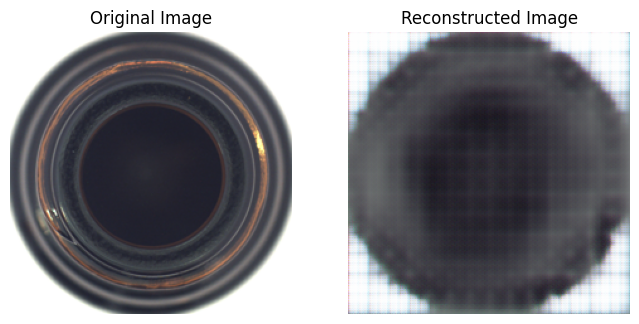

-------- epoch 1 --------


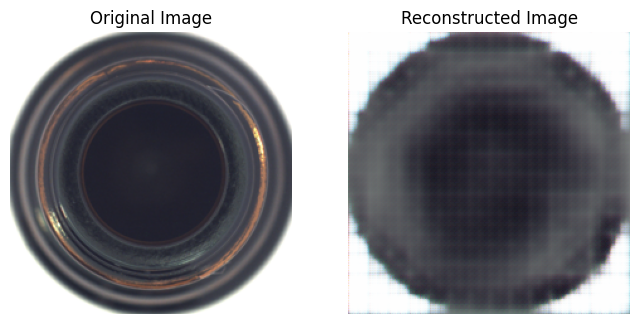

-------- epoch 2 --------


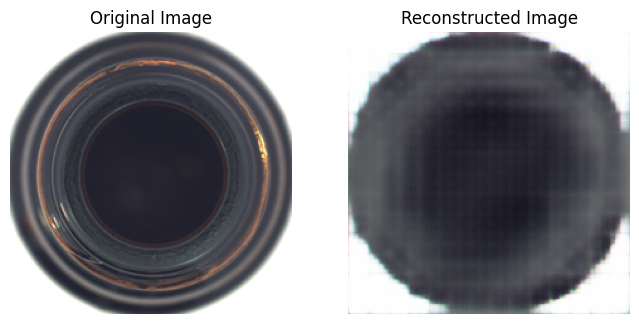

-------- epoch 3 --------


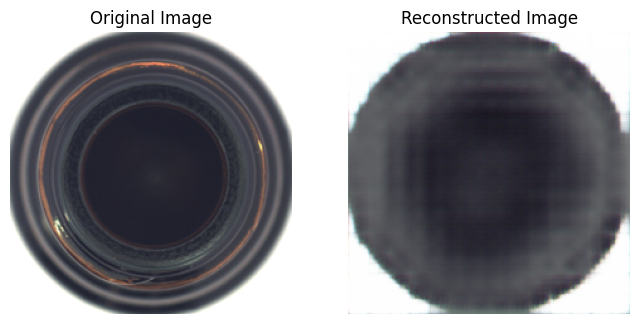

-------- epoch 4 --------


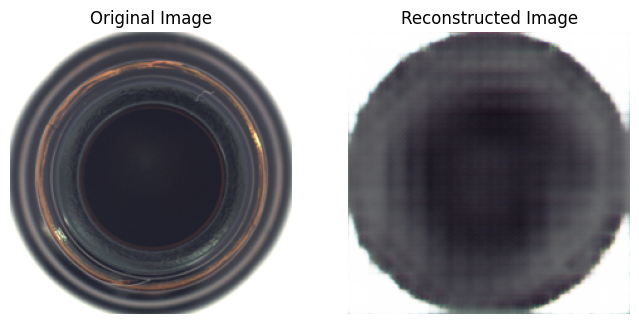

-------- epoch 5 --------


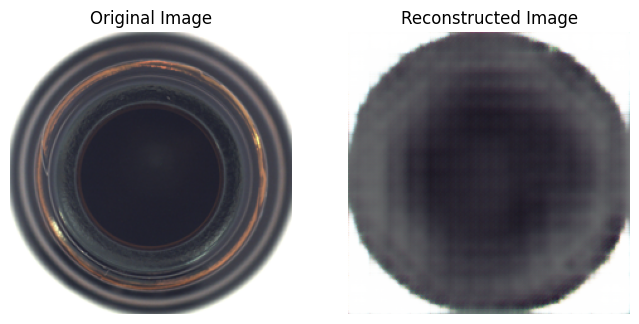

-------- epoch 6 --------


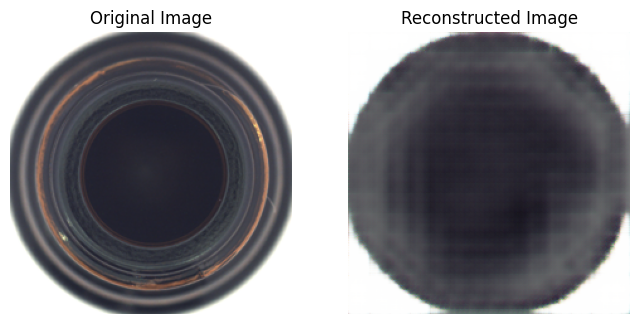

-------- epoch 7 --------


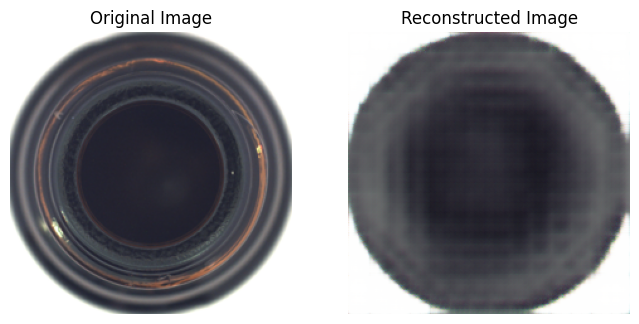

-------- epoch 8 --------


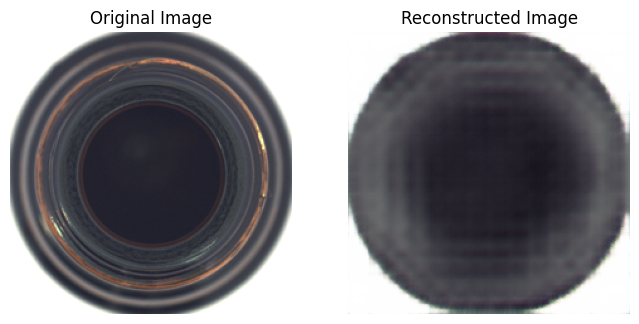

-------- epoch 9 --------


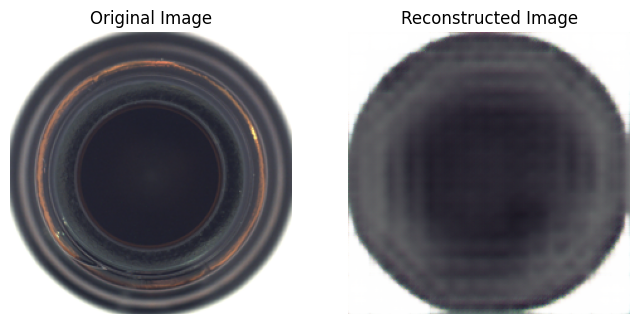

-------- epoch 10 --------


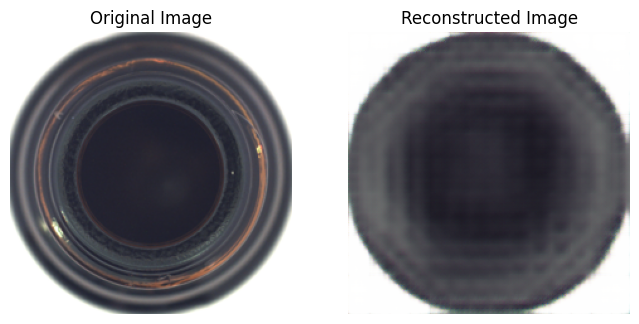

-------- epoch 11 --------


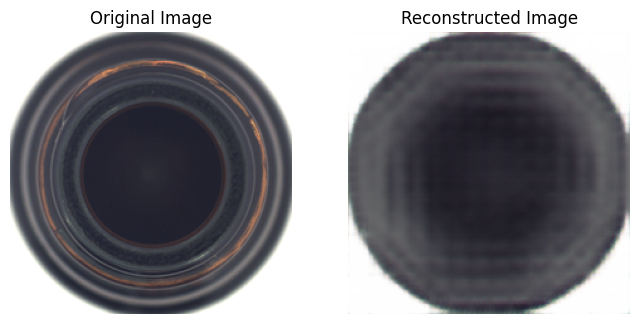

-------- epoch 12 --------


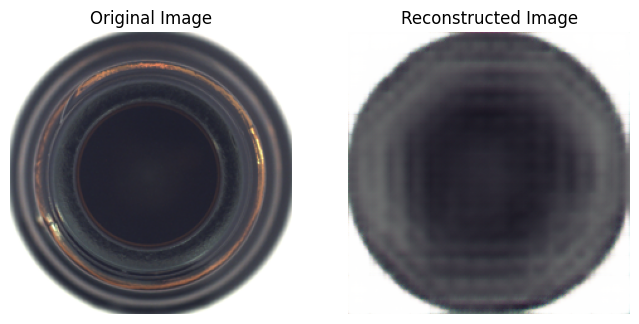

-------- epoch 13 --------


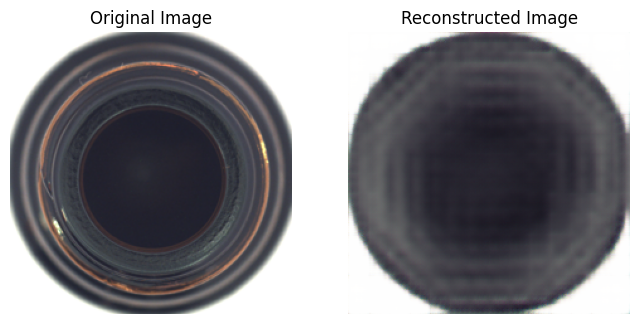

-------- epoch 14 --------


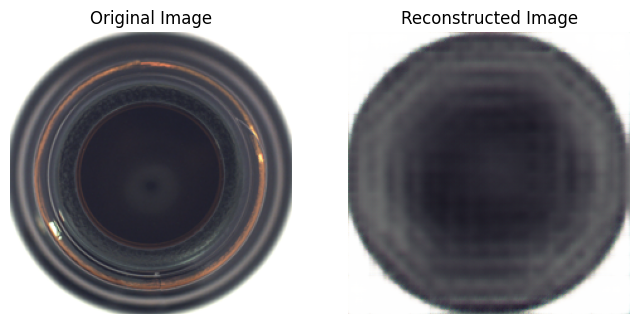

-------- epoch 15 --------


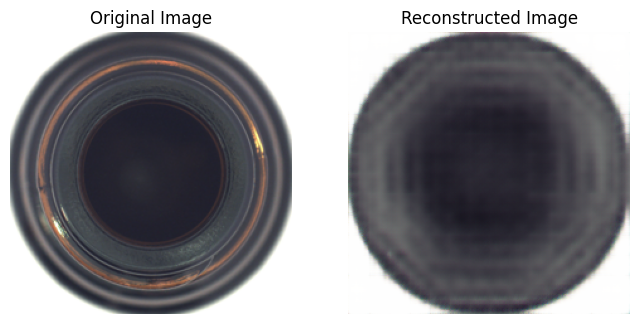

-------- epoch 16 --------


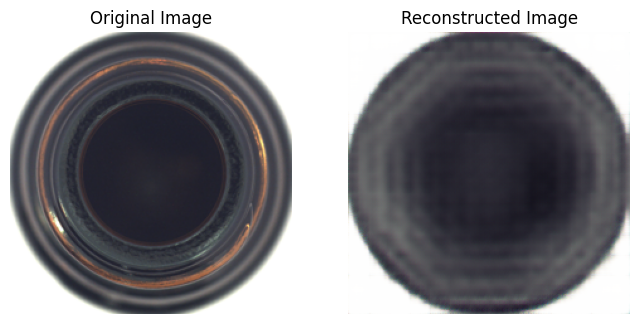

-------- epoch 17 --------


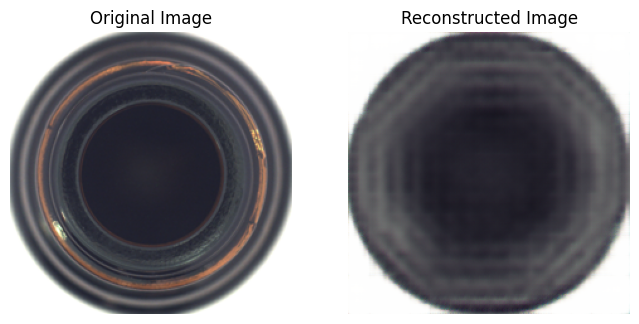

-------- epoch 18 --------


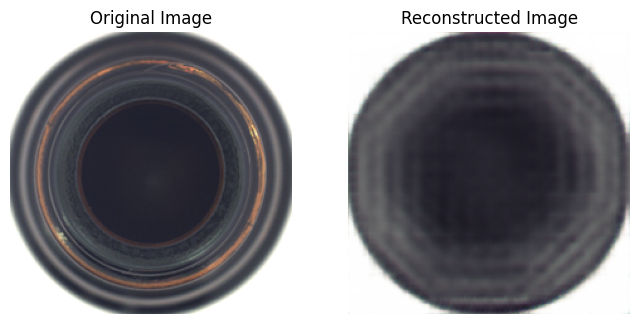

-------- epoch 19 --------


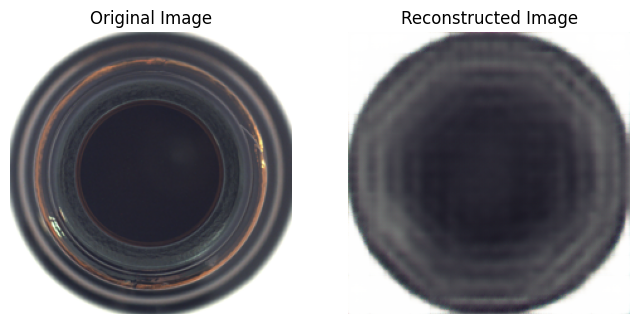

-------- epoch 20 --------


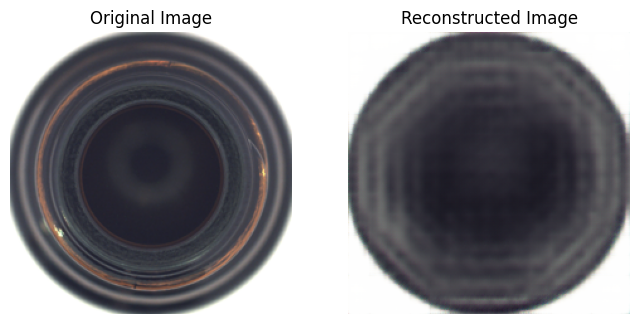

-------- epoch 21 --------


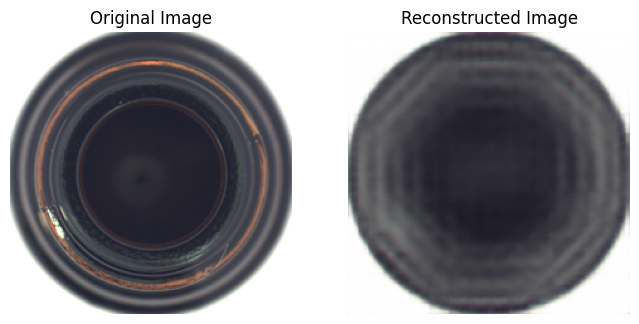

-------- epoch 22 --------


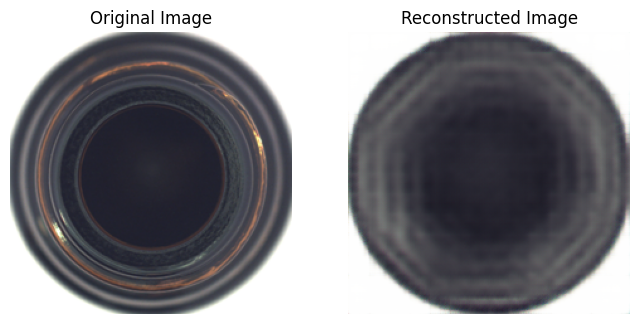

-------- epoch 23 --------


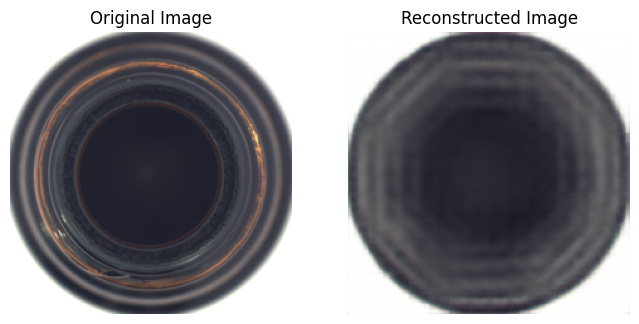

-------- epoch 24 --------


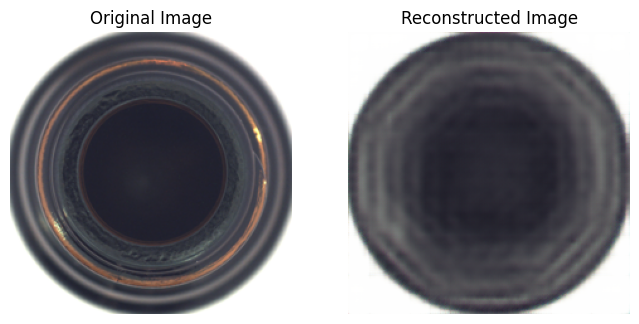

-------- epoch 25 --------


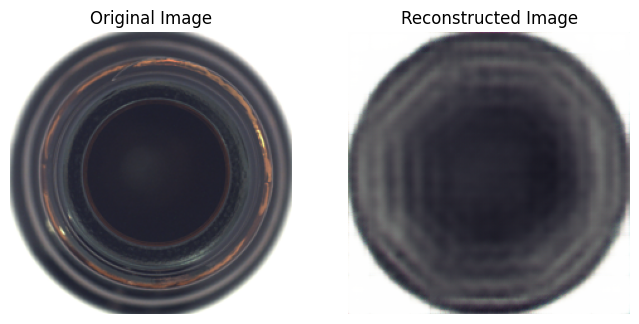

-------- epoch 26 --------


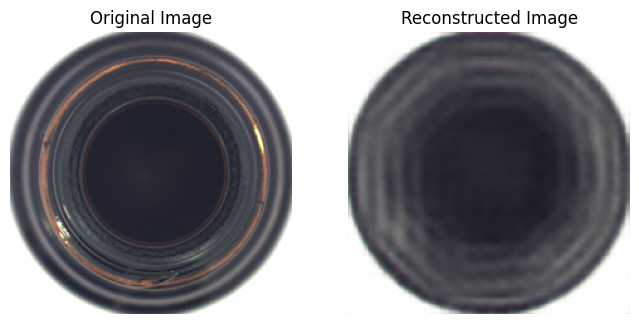

-------- epoch 27 --------


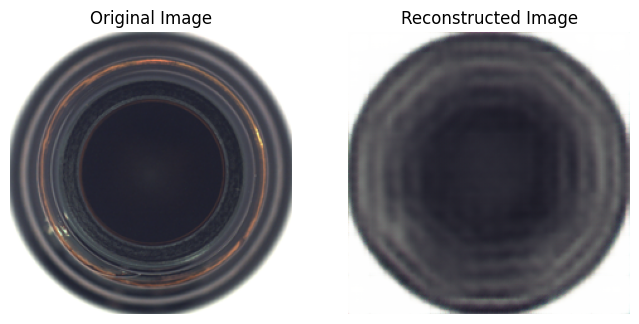

-------- epoch 28 --------


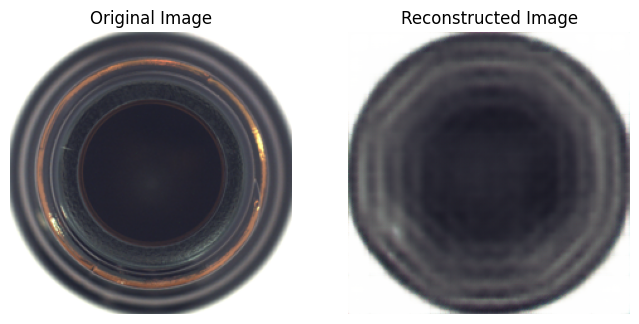

-------- epoch 29 --------


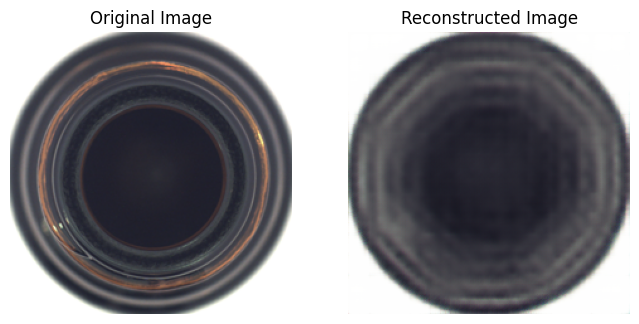

-------- epoch 30 --------


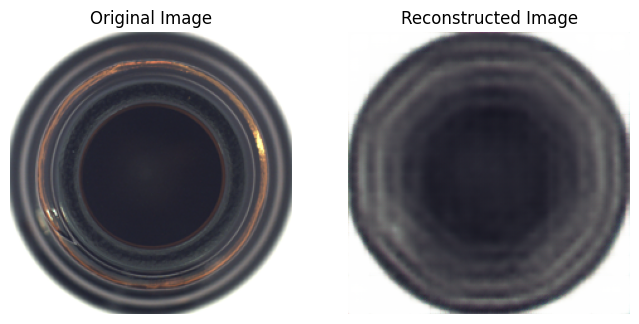

-------- epoch 31 --------


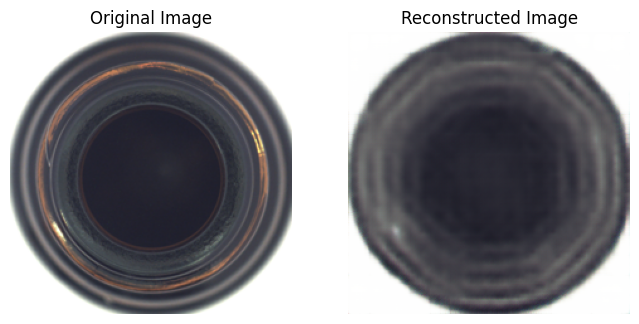

-------- epoch 32 --------


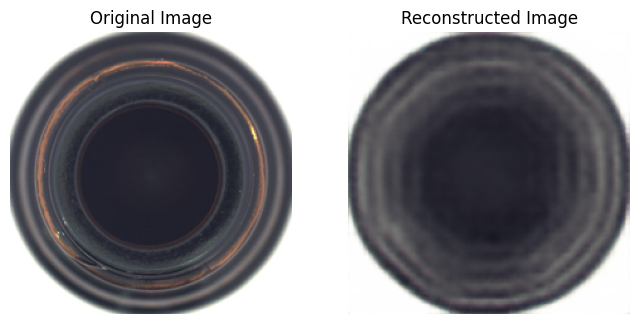

-------- epoch 33 --------


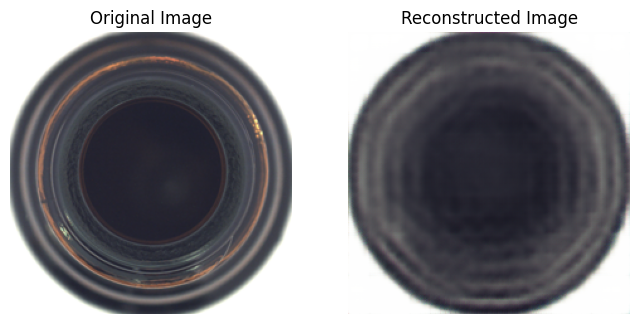

-------- epoch 34 --------


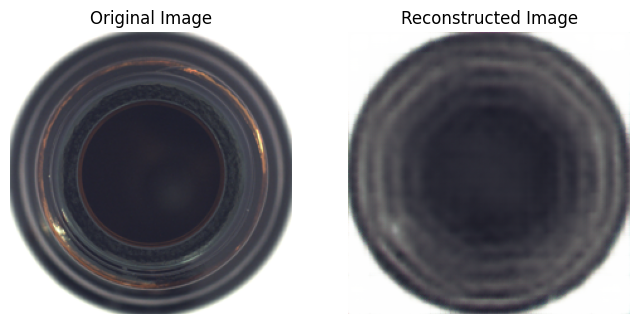

-------- epoch 35 --------


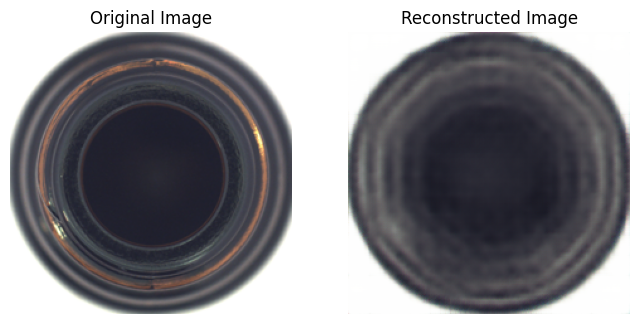

-------- epoch 36 --------


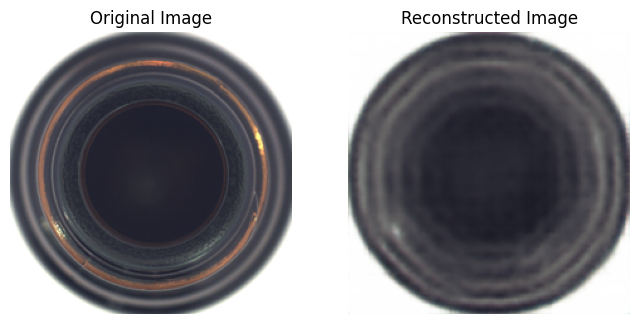

-------- epoch 37 --------


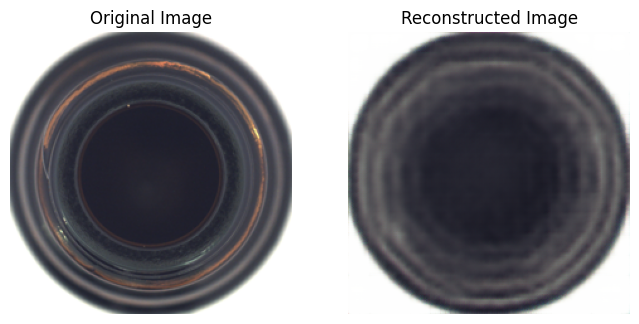

-------- epoch 38 --------


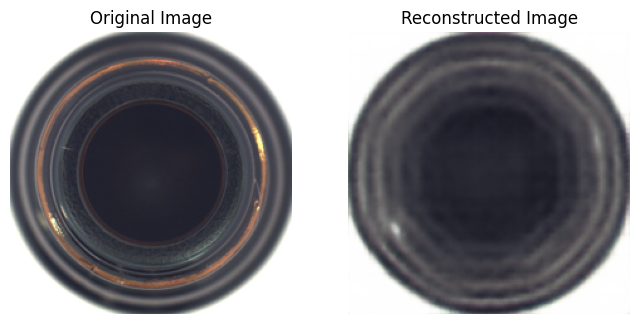

-------- epoch 39 --------


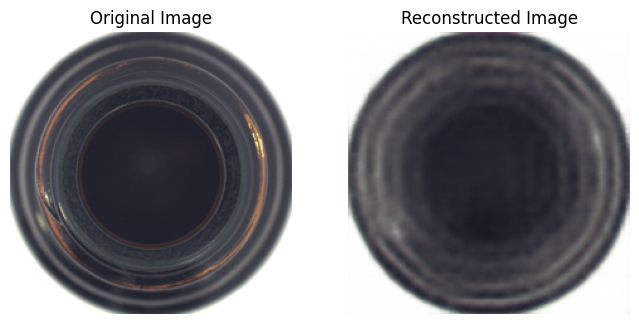

-------- epoch 40 --------


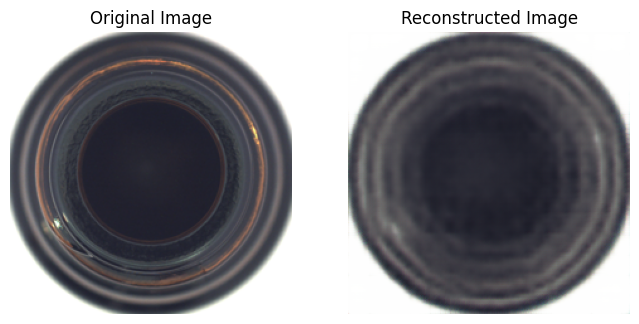

-------- epoch 41 --------


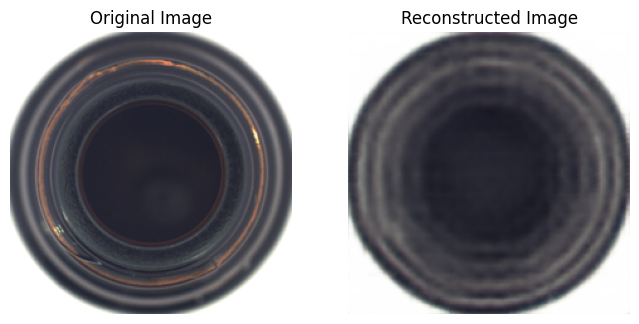

-------- epoch 42 --------


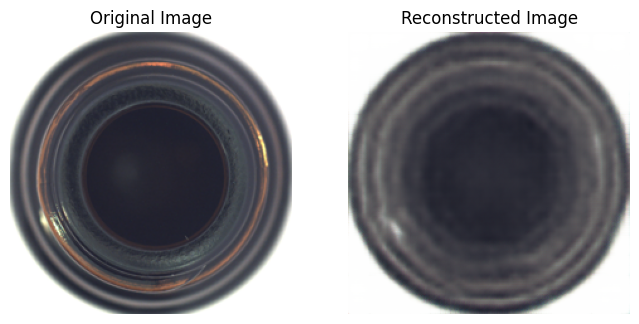

-------- epoch 43 --------


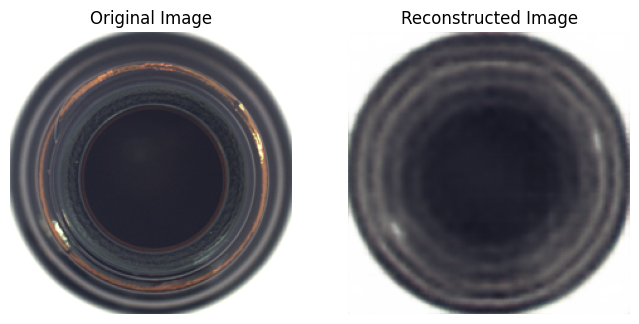

-------- epoch 44 --------


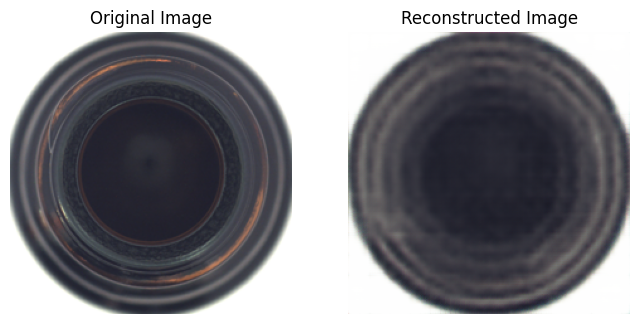

-------- epoch 45 --------


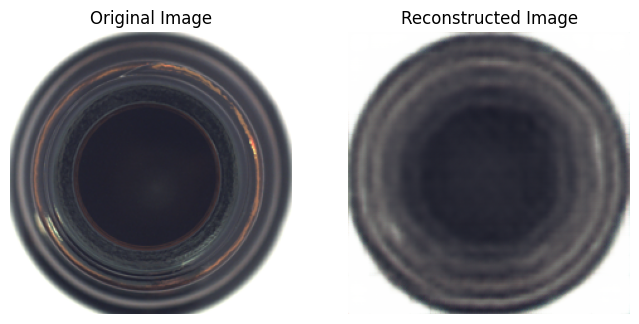

-------- epoch 46 --------


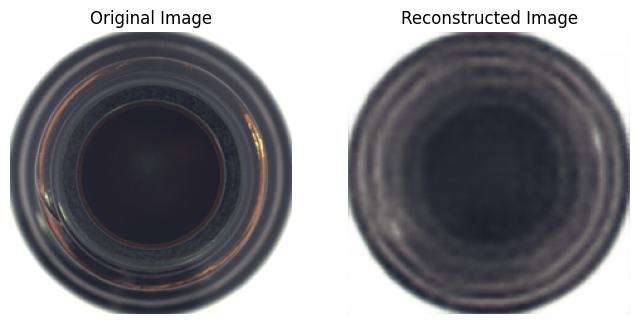

-------- epoch 47 --------


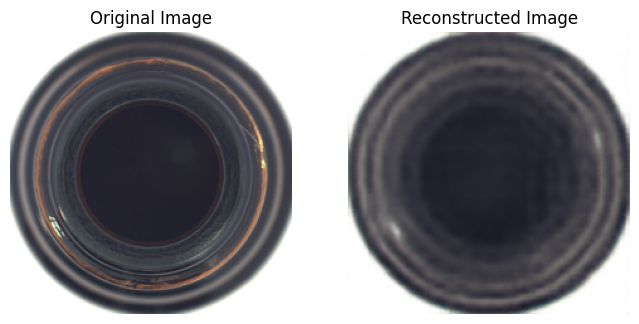

-------- epoch 48 --------


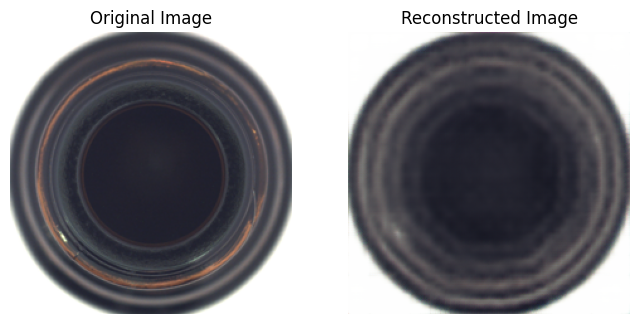

-------- epoch 49 --------


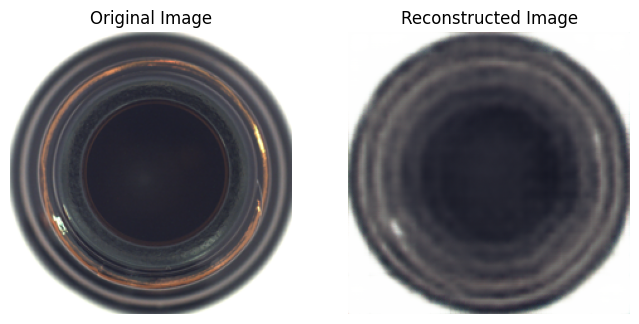

In [197]:
for idx in range(50):
    print(f'-------- epoch {idx} --------')
    for l in range(1):
        input_image = epoch_img[idx][0][0]
        reconstructed_image = epoch_img[idx][0][1]
    
        # 시각화
        plt.figure(figsize=(8, 4))
    
        # 원본 이미지
        plt.subplot(1, 2, 1)
        plt.title("Original Image")
        plt.imshow(input_image.permute(1, 2, 0).numpy())
        plt.axis("off")
    
        # 재구성 이미지
        plt.subplot(1, 2, 2)
        plt.title("Reconstructed Image")
        plt.imshow(reconstructed_image.permute(1, 2, 0).numpy())
        plt.axis("off")
        plt.show()

## load checkpoint

In [219]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = AnomalyDetectionModel().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
path = 'C:\\Users\\dongwon\\OneDrive - seoultech.ac.kr\\바탕 화면\\jupyter notebook\\스마트팜\\dinomaly\\base_model_checkpoint\\49_checkpoint.pth'
model, _, _, _ = load_checkpoint(model, optimizer, path)
epoch_img = train_model(model, trainloader, optimizer, num_epochs=950, start_epoch=49)

Checkpoint loaded from epoch 49


Epoch 1/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [1/950], Loss: 0.0023
Checkpoint saved at epoch 50


Epoch 2/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [2/950], Loss: 0.0022
Checkpoint saved at epoch 51


Epoch 3/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [3/950], Loss: 0.0022
Checkpoint saved at epoch 52


Epoch 4/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [4/950], Loss: 0.0022
Checkpoint saved at epoch 53


Epoch 5/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [5/950], Loss: 0.0022
Checkpoint saved at epoch 54


Epoch 6/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [6/950], Loss: 0.0022
Checkpoint saved at epoch 55


Epoch 7/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [7/950], Loss: 0.0022
Checkpoint saved at epoch 56


Epoch 8/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [8/950], Loss: 0.0021
Checkpoint saved at epoch 57


Epoch 9/950: 100%|███████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [9/950], Loss: 0.0022
Checkpoint saved at epoch 58


Epoch 10/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [10/950], Loss: 0.0021
Checkpoint saved at epoch 59


Epoch 11/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [11/950], Loss: 0.0021
Checkpoint saved at epoch 60


Epoch 12/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [12/950], Loss: 0.0021
Checkpoint saved at epoch 61


Epoch 13/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [13/950], Loss: 0.0021
Checkpoint saved at epoch 62


Epoch 14/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [14/950], Loss: 0.0021
Checkpoint saved at epoch 63


Epoch 15/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [15/950], Loss: 0.0021
Checkpoint saved at epoch 64


Epoch 16/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [16/950], Loss: 0.0020
Checkpoint saved at epoch 65


Epoch 17/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [17/950], Loss: 0.0020
Checkpoint saved at epoch 66


Epoch 18/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [18/950], Loss: 0.0020
Checkpoint saved at epoch 67


Epoch 19/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [19/950], Loss: 0.0020
Checkpoint saved at epoch 68


Epoch 20/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [20/950], Loss: 0.0020
Checkpoint saved at epoch 69


Epoch 21/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [21/950], Loss: 0.0019
Checkpoint saved at epoch 70


Epoch 22/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [22/950], Loss: 0.0019
Checkpoint saved at epoch 71


Epoch 23/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [23/950], Loss: 0.0019
Checkpoint saved at epoch 72


Epoch 24/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [24/950], Loss: 0.0019
Checkpoint saved at epoch 73


Epoch 25/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [25/950], Loss: 0.0019
Checkpoint saved at epoch 74


Epoch 26/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [26/950], Loss: 0.0019
Checkpoint saved at epoch 75


Epoch 27/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [27/950], Loss: 0.0018
Checkpoint saved at epoch 76


Epoch 28/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [28/950], Loss: 0.0018
Checkpoint saved at epoch 77


Epoch 29/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [29/950], Loss: 0.0019
Checkpoint saved at epoch 78


Epoch 30/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [30/950], Loss: 0.0020
Checkpoint saved at epoch 79


Epoch 31/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [31/950], Loss: 0.0018
Checkpoint saved at epoch 80


Epoch 32/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [32/950], Loss: 0.0018
Checkpoint saved at epoch 81


Epoch 33/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [33/950], Loss: 0.0019
Checkpoint saved at epoch 82


Epoch 34/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [34/950], Loss: 0.0019
Checkpoint saved at epoch 83


Epoch 35/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [35/950], Loss: 0.0019
Checkpoint saved at epoch 84


Epoch 36/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [36/950], Loss: 0.0018
Checkpoint saved at epoch 85


Epoch 37/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [37/950], Loss: 0.0018
Checkpoint saved at epoch 86


Epoch 38/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [38/950], Loss: 0.0017
Checkpoint saved at epoch 87


Epoch 39/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [39/950], Loss: 0.0017
Checkpoint saved at epoch 88


Epoch 40/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [40/950], Loss: 0.0017
Checkpoint saved at epoch 89


Epoch 41/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [41/950], Loss: 0.0017
Checkpoint saved at epoch 90


Epoch 42/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [42/950], Loss: 0.0017
Checkpoint saved at epoch 91


Epoch 43/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [43/950], Loss: 0.0017
Checkpoint saved at epoch 92


Epoch 44/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [44/950], Loss: 0.0017
Checkpoint saved at epoch 93


Epoch 45/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [45/950], Loss: 0.0017
Checkpoint saved at epoch 94


Epoch 46/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [46/950], Loss: 0.0018
Checkpoint saved at epoch 95


Epoch 47/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [47/950], Loss: 0.0017
Checkpoint saved at epoch 96


Epoch 48/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [48/950], Loss: 0.0017
Checkpoint saved at epoch 97


Epoch 49/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [49/950], Loss: 0.0017
Checkpoint saved at epoch 98


Epoch 50/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [50/950], Loss: 0.0017
Checkpoint saved at epoch 99


Epoch 51/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [51/950], Loss: 0.0017
Checkpoint saved at epoch 100


Epoch 52/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [52/950], Loss: 0.0016
Checkpoint saved at epoch 101


Epoch 53/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [53/950], Loss: 0.0016
Checkpoint saved at epoch 102


Epoch 54/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [54/950], Loss: 0.0016
Checkpoint saved at epoch 103


Epoch 55/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [55/950], Loss: 0.0016
Checkpoint saved at epoch 104


Epoch 56/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [56/950], Loss: 0.0017
Checkpoint saved at epoch 105


Epoch 57/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [57/950], Loss: 0.0016
Checkpoint saved at epoch 106


Epoch 58/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [58/950], Loss: 0.0016
Checkpoint saved at epoch 107


Epoch 59/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [59/950], Loss: 0.0016
Checkpoint saved at epoch 108


Epoch 60/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [60/950], Loss: 0.0016
Checkpoint saved at epoch 109


Epoch 61/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [61/950], Loss: 0.0016
Checkpoint saved at epoch 110


Epoch 62/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [62/950], Loss: 0.0016
Checkpoint saved at epoch 111


Epoch 63/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [63/950], Loss: 0.0016
Checkpoint saved at epoch 112


Epoch 64/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [64/950], Loss: 0.0016
Checkpoint saved at epoch 113


Epoch 65/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [65/950], Loss: 0.0016
Checkpoint saved at epoch 114


Epoch 66/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [66/950], Loss: 0.0016
Checkpoint saved at epoch 115


Epoch 67/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [67/950], Loss: 0.0016
Checkpoint saved at epoch 116


Epoch 68/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [68/950], Loss: 0.0016
Checkpoint saved at epoch 117


Epoch 69/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [69/950], Loss: 0.0016
Checkpoint saved at epoch 118


Epoch 70/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [70/950], Loss: 0.0017
Checkpoint saved at epoch 119


Epoch 71/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [71/950], Loss: 0.0016
Checkpoint saved at epoch 120


Epoch 72/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [72/950], Loss: 0.0016
Checkpoint saved at epoch 121


Epoch 73/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [73/950], Loss: 0.0016
Checkpoint saved at epoch 122


Epoch 74/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [74/950], Loss: 0.0015
Checkpoint saved at epoch 123


Epoch 75/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [75/950], Loss: 0.0015
Checkpoint saved at epoch 124


Epoch 76/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [76/950], Loss: 0.0015
Checkpoint saved at epoch 125


Epoch 77/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [77/950], Loss: 0.0015
Checkpoint saved at epoch 126


Epoch 78/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [78/950], Loss: 0.0015
Checkpoint saved at epoch 127


Epoch 79/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [79/950], Loss: 0.0015
Checkpoint saved at epoch 128


Epoch 80/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [80/950], Loss: 0.0016
Checkpoint saved at epoch 129


Epoch 81/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [81/950], Loss: 0.0016
Checkpoint saved at epoch 130


Epoch 82/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [82/950], Loss: 0.0016
Checkpoint saved at epoch 131


Epoch 83/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [83/950], Loss: 0.0015
Checkpoint saved at epoch 132


Epoch 84/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [84/950], Loss: 0.0015
Checkpoint saved at epoch 133


Epoch 85/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [85/950], Loss: 0.0015
Checkpoint saved at epoch 134


Epoch 86/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [86/950], Loss: 0.0015
Checkpoint saved at epoch 135


Epoch 87/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [87/950], Loss: 0.0015
Checkpoint saved at epoch 136


Epoch 88/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [88/950], Loss: 0.0014
Checkpoint saved at epoch 137


Epoch 89/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [89/950], Loss: 0.0014
Checkpoint saved at epoch 138


Epoch 90/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [90/950], Loss: 0.0014
Checkpoint saved at epoch 139


Epoch 91/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [91/950], Loss: 0.0015
Checkpoint saved at epoch 140


Epoch 92/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [92/950], Loss: 0.0014
Checkpoint saved at epoch 141


Epoch 93/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [93/950], Loss: 0.0014
Checkpoint saved at epoch 142


Epoch 94/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [94/950], Loss: 0.0015
Checkpoint saved at epoch 143


Epoch 95/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [95/950], Loss: 0.0014
Checkpoint saved at epoch 144


Epoch 96/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [96/950], Loss: 0.0014
Checkpoint saved at epoch 145


Epoch 97/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [97/950], Loss: 0.0014
Checkpoint saved at epoch 146


Epoch 98/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [98/950], Loss: 0.0015
Checkpoint saved at epoch 147


Epoch 99/950: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [99/950], Loss: 0.0014
Checkpoint saved at epoch 148


Epoch 100/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [100/950], Loss: 0.0014
Checkpoint saved at epoch 149


Epoch 101/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [101/950], Loss: 0.0014
Checkpoint saved at epoch 150


Epoch 102/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [102/950], Loss: 0.0014
Checkpoint saved at epoch 151


Epoch 103/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [103/950], Loss: 0.0015
Checkpoint saved at epoch 152


Epoch 104/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [104/950], Loss: 0.0014
Checkpoint saved at epoch 153


Epoch 105/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [105/950], Loss: 0.0014
Checkpoint saved at epoch 154


Epoch 106/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [106/950], Loss: 0.0014
Checkpoint saved at epoch 155


Epoch 107/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [107/950], Loss: 0.0014
Checkpoint saved at epoch 156


Epoch 108/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [108/950], Loss: 0.0015
Checkpoint saved at epoch 157


Epoch 109/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [109/950], Loss: 0.0014
Checkpoint saved at epoch 158


Epoch 110/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [110/950], Loss: 0.0015
Checkpoint saved at epoch 159


Epoch 111/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [111/950], Loss: 0.0015
Checkpoint saved at epoch 160


Epoch 112/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [112/950], Loss: 0.0014
Checkpoint saved at epoch 161


Epoch 113/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [113/950], Loss: 0.0014
Checkpoint saved at epoch 162


Epoch 114/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [114/950], Loss: 0.0014
Checkpoint saved at epoch 163


Epoch 115/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [115/950], Loss: 0.0013
Checkpoint saved at epoch 164


Epoch 116/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.88s/it]


Epoch [116/950], Loss: 0.0014
Checkpoint saved at epoch 165


Epoch 117/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [117/950], Loss: 0.0014
Checkpoint saved at epoch 166


Epoch 118/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [118/950], Loss: 0.0014
Checkpoint saved at epoch 167


Epoch 119/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [119/950], Loss: 0.0014
Checkpoint saved at epoch 168


Epoch 120/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [120/950], Loss: 0.0014
Checkpoint saved at epoch 169


Epoch 121/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [121/950], Loss: 0.0014
Checkpoint saved at epoch 170


Epoch 122/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [122/950], Loss: 0.0013
Checkpoint saved at epoch 171


Epoch 123/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [123/950], Loss: 0.0013
Checkpoint saved at epoch 172


Epoch 124/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [124/950], Loss: 0.0014
Checkpoint saved at epoch 173


Epoch 125/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [125/950], Loss: 0.0014
Checkpoint saved at epoch 174


Epoch 126/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [126/950], Loss: 0.0014
Checkpoint saved at epoch 175


Epoch 127/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [127/950], Loss: 0.0014
Checkpoint saved at epoch 176


Epoch 128/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [128/950], Loss: 0.0014
Checkpoint saved at epoch 177


Epoch 129/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [129/950], Loss: 0.0014
Checkpoint saved at epoch 178


Epoch 130/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [130/950], Loss: 0.0013
Checkpoint saved at epoch 179


Epoch 131/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [131/950], Loss: 0.0013
Checkpoint saved at epoch 180


Epoch 132/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [132/950], Loss: 0.0013
Checkpoint saved at epoch 181


Epoch 133/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [133/950], Loss: 0.0013
Checkpoint saved at epoch 182


Epoch 134/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [134/950], Loss: 0.0013
Checkpoint saved at epoch 183


Epoch 135/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [135/950], Loss: 0.0013
Checkpoint saved at epoch 184


Epoch 136/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [136/950], Loss: 0.0013
Checkpoint saved at epoch 185


Epoch 137/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [137/950], Loss: 0.0013
Checkpoint saved at epoch 186


Epoch 138/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [138/950], Loss: 0.0013
Checkpoint saved at epoch 187


Epoch 139/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [139/950], Loss: 0.0013
Checkpoint saved at epoch 188


Epoch 140/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [140/950], Loss: 0.0013
Checkpoint saved at epoch 189


Epoch 141/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [141/950], Loss: 0.0013
Checkpoint saved at epoch 190


Epoch 142/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [142/950], Loss: 0.0013
Checkpoint saved at epoch 191


Epoch 143/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [143/950], Loss: 0.0013
Checkpoint saved at epoch 192


Epoch 144/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [144/950], Loss: 0.0013
Checkpoint saved at epoch 193


Epoch 145/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [145/950], Loss: 0.0013
Checkpoint saved at epoch 194


Epoch 146/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [146/950], Loss: 0.0012
Checkpoint saved at epoch 195


Epoch 147/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [147/950], Loss: 0.0013
Checkpoint saved at epoch 196


Epoch 148/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [148/950], Loss: 0.0014
Checkpoint saved at epoch 197


Epoch 149/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [149/950], Loss: 0.0012
Checkpoint saved at epoch 198


Epoch 150/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [150/950], Loss: 0.0012
Checkpoint saved at epoch 199


Epoch 151/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [151/950], Loss: 0.0012
Checkpoint saved at epoch 200


Epoch 152/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [152/950], Loss: 0.0013
Checkpoint saved at epoch 201


Epoch 153/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [153/950], Loss: 0.0014
Checkpoint saved at epoch 202


Epoch 154/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [154/950], Loss: 0.0013
Checkpoint saved at epoch 203


Epoch 155/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [155/950], Loss: 0.0013
Checkpoint saved at epoch 204


Epoch 156/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [156/950], Loss: 0.0014
Checkpoint saved at epoch 205


Epoch 157/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [157/950], Loss: 0.0013
Checkpoint saved at epoch 206


Epoch 158/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [158/950], Loss: 0.0013
Checkpoint saved at epoch 207


Epoch 159/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [159/950], Loss: 0.0013
Checkpoint saved at epoch 208


Epoch 160/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [160/950], Loss: 0.0012
Checkpoint saved at epoch 209


Epoch 161/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [161/950], Loss: 0.0013
Checkpoint saved at epoch 210


Epoch 162/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [162/950], Loss: 0.0012
Checkpoint saved at epoch 211


Epoch 163/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [163/950], Loss: 0.0012
Checkpoint saved at epoch 212


Epoch 164/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [164/950], Loss: 0.0012
Checkpoint saved at epoch 213


Epoch 165/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [165/950], Loss: 0.0012
Checkpoint saved at epoch 214


Epoch 166/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [166/950], Loss: 0.0012
Checkpoint saved at epoch 215


Epoch 167/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [167/950], Loss: 0.0012
Checkpoint saved at epoch 216


Epoch 168/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [168/950], Loss: 0.0012
Checkpoint saved at epoch 217


Epoch 169/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [169/950], Loss: 0.0013
Checkpoint saved at epoch 218


Epoch 170/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [170/950], Loss: 0.0013
Checkpoint saved at epoch 219


Epoch 171/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [171/950], Loss: 0.0012
Checkpoint saved at epoch 220


Epoch 172/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [172/950], Loss: 0.0012
Checkpoint saved at epoch 221


Epoch 173/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [173/950], Loss: 0.0012
Checkpoint saved at epoch 222


Epoch 174/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [174/950], Loss: 0.0012
Checkpoint saved at epoch 223


Epoch 175/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [175/950], Loss: 0.0013
Checkpoint saved at epoch 224


Epoch 176/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [176/950], Loss: 0.0012
Checkpoint saved at epoch 225


Epoch 177/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [177/950], Loss: 0.0012
Checkpoint saved at epoch 226


Epoch 178/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [178/950], Loss: 0.0012
Checkpoint saved at epoch 227


Epoch 179/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [179/950], Loss: 0.0013
Checkpoint saved at epoch 228


Epoch 180/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [180/950], Loss: 0.0012
Checkpoint saved at epoch 229


Epoch 181/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [181/950], Loss: 0.0012
Checkpoint saved at epoch 230


Epoch 182/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [182/950], Loss: 0.0012
Checkpoint saved at epoch 231


Epoch 183/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [183/950], Loss: 0.0012
Checkpoint saved at epoch 232


Epoch 184/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [184/950], Loss: 0.0013
Checkpoint saved at epoch 233


Epoch 185/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [185/950], Loss: 0.0012
Checkpoint saved at epoch 234


Epoch 186/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [186/950], Loss: 0.0012
Checkpoint saved at epoch 235


Epoch 187/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [187/950], Loss: 0.0012
Checkpoint saved at epoch 236


Epoch 188/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [188/950], Loss: 0.0012
Checkpoint saved at epoch 237


Epoch 189/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [189/950], Loss: 0.0012
Checkpoint saved at epoch 238


Epoch 190/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [190/950], Loss: 0.0012
Checkpoint saved at epoch 239


Epoch 191/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [191/950], Loss: 0.0012
Checkpoint saved at epoch 240


Epoch 192/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [192/950], Loss: 0.0012
Checkpoint saved at epoch 241


Epoch 193/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [193/950], Loss: 0.0012
Checkpoint saved at epoch 242


Epoch 194/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [194/950], Loss: 0.0012
Checkpoint saved at epoch 243


Epoch 195/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.19s/it]


Epoch [195/950], Loss: 0.0012
Checkpoint saved at epoch 244


Epoch 196/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [196/950], Loss: 0.0012
Checkpoint saved at epoch 245


Epoch 197/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [197/950], Loss: 0.0012
Checkpoint saved at epoch 246


Epoch 198/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [198/950], Loss: 0.0012
Checkpoint saved at epoch 247


Epoch 199/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [199/950], Loss: 0.0012
Checkpoint saved at epoch 248


Epoch 200/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [200/950], Loss: 0.0012
Checkpoint saved at epoch 249


Epoch 201/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [201/950], Loss: 0.0011
Checkpoint saved at epoch 250


Epoch 202/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [202/950], Loss: 0.0011
Checkpoint saved at epoch 251


Epoch 203/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [203/950], Loss: 0.0012
Checkpoint saved at epoch 252


Epoch 204/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [204/950], Loss: 0.0011
Checkpoint saved at epoch 253


Epoch 205/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [205/950], Loss: 0.0011
Checkpoint saved at epoch 254


Epoch 206/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [206/950], Loss: 0.0011
Checkpoint saved at epoch 255


Epoch 207/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [207/950], Loss: 0.0012
Checkpoint saved at epoch 256


Epoch 208/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [208/950], Loss: 0.0012
Checkpoint saved at epoch 257


Epoch 209/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [209/950], Loss: 0.0011
Checkpoint saved at epoch 258


Epoch 210/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [210/950], Loss: 0.0011
Checkpoint saved at epoch 259


Epoch 211/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [211/950], Loss: 0.0011
Checkpoint saved at epoch 260


Epoch 212/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [212/950], Loss: 0.0012
Checkpoint saved at epoch 261


Epoch 213/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [213/950], Loss: 0.0011
Checkpoint saved at epoch 262


Epoch 214/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [214/950], Loss: 0.0012
Checkpoint saved at epoch 263


Epoch 215/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [215/950], Loss: 0.0011
Checkpoint saved at epoch 264


Epoch 216/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [216/950], Loss: 0.0011
Checkpoint saved at epoch 265


Epoch 217/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [217/950], Loss: 0.0011
Checkpoint saved at epoch 266


Epoch 218/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [218/950], Loss: 0.0011
Checkpoint saved at epoch 267


Epoch 219/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [219/950], Loss: 0.0011
Checkpoint saved at epoch 268


Epoch 220/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [220/950], Loss: 0.0011
Checkpoint saved at epoch 269


Epoch 221/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [221/950], Loss: 0.0011
Checkpoint saved at epoch 270


Epoch 222/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [222/950], Loss: 0.0012
Checkpoint saved at epoch 271


Epoch 223/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [223/950], Loss: 0.0011
Checkpoint saved at epoch 272


Epoch 224/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [224/950], Loss: 0.0011
Checkpoint saved at epoch 273


Epoch 225/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [225/950], Loss: 0.0011
Checkpoint saved at epoch 274


Epoch 226/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [226/950], Loss: 0.0011
Checkpoint saved at epoch 275


Epoch 227/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [227/950], Loss: 0.0011
Checkpoint saved at epoch 276


Epoch 228/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [228/950], Loss: 0.0011
Checkpoint saved at epoch 277


Epoch 229/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [229/950], Loss: 0.0012
Checkpoint saved at epoch 278


Epoch 230/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [230/950], Loss: 0.0012
Checkpoint saved at epoch 279


Epoch 231/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [231/950], Loss: 0.0011
Checkpoint saved at epoch 280


Epoch 232/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [232/950], Loss: 0.0012
Checkpoint saved at epoch 281


Epoch 233/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [233/950], Loss: 0.0011
Checkpoint saved at epoch 282


Epoch 234/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [234/950], Loss: 0.0011
Checkpoint saved at epoch 283


Epoch 235/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [235/950], Loss: 0.0011
Checkpoint saved at epoch 284


Epoch 236/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [236/950], Loss: 0.0011
Checkpoint saved at epoch 285


Epoch 237/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [237/950], Loss: 0.0011
Checkpoint saved at epoch 286


Epoch 238/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [238/950], Loss: 0.0011
Checkpoint saved at epoch 287


Epoch 239/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [239/950], Loss: 0.0011
Checkpoint saved at epoch 288


Epoch 240/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [240/950], Loss: 0.0011
Checkpoint saved at epoch 289


Epoch 241/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [241/950], Loss: 0.0011
Checkpoint saved at epoch 290


Epoch 242/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [242/950], Loss: 0.0011
Checkpoint saved at epoch 291


Epoch 243/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [243/950], Loss: 0.0011
Checkpoint saved at epoch 292


Epoch 244/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [244/950], Loss: 0.0011
Checkpoint saved at epoch 293


Epoch 245/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [245/950], Loss: 0.0011
Checkpoint saved at epoch 294


Epoch 246/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [246/950], Loss: 0.0012
Checkpoint saved at epoch 295


Epoch 247/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [247/950], Loss: 0.0011
Checkpoint saved at epoch 296


Epoch 248/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [248/950], Loss: 0.0011
Checkpoint saved at epoch 297


Epoch 249/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [249/950], Loss: 0.0012
Checkpoint saved at epoch 298


Epoch 250/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [250/950], Loss: 0.0012
Checkpoint saved at epoch 299


Epoch 251/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [251/950], Loss: 0.0011
Checkpoint saved at epoch 300


Epoch 252/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.88s/it]


Epoch [252/950], Loss: 0.0011
Checkpoint saved at epoch 301


Epoch 253/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [253/950], Loss: 0.0011
Checkpoint saved at epoch 302


Epoch 254/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [254/950], Loss: 0.0011
Checkpoint saved at epoch 303


Epoch 255/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.88s/it]


Epoch [255/950], Loss: 0.0011
Checkpoint saved at epoch 304


Epoch 256/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [256/950], Loss: 0.0010
Checkpoint saved at epoch 305


Epoch 257/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [257/950], Loss: 0.0010
Checkpoint saved at epoch 306


Epoch 258/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [258/950], Loss: 0.0010
Checkpoint saved at epoch 307


Epoch 259/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [259/950], Loss: 0.0010
Checkpoint saved at epoch 308


Epoch 260/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [260/950], Loss: 0.0010
Checkpoint saved at epoch 309


Epoch 261/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [261/950], Loss: 0.0010
Checkpoint saved at epoch 310


Epoch 262/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [262/950], Loss: 0.0010
Checkpoint saved at epoch 311


Epoch 263/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [263/950], Loss: 0.0010
Checkpoint saved at epoch 312


Epoch 264/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [264/950], Loss: 0.0010
Checkpoint saved at epoch 313


Epoch 265/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [265/950], Loss: 0.0011
Checkpoint saved at epoch 314


Epoch 266/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [266/950], Loss: 0.0011
Checkpoint saved at epoch 315


Epoch 267/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [267/950], Loss: 0.0011
Checkpoint saved at epoch 316


Epoch 268/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [268/950], Loss: 0.0011
Checkpoint saved at epoch 317


Epoch 269/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [269/950], Loss: 0.0011
Checkpoint saved at epoch 318


Epoch 270/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [270/950], Loss: 0.0011
Checkpoint saved at epoch 319


Epoch 271/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [271/950], Loss: 0.0011
Checkpoint saved at epoch 320


Epoch 272/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [272/950], Loss: 0.0011
Checkpoint saved at epoch 321


Epoch 273/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [273/950], Loss: 0.0010
Checkpoint saved at epoch 322


Epoch 274/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [274/950], Loss: 0.0010
Checkpoint saved at epoch 323


Epoch 275/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [275/950], Loss: 0.0010
Checkpoint saved at epoch 324


Epoch 276/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [276/950], Loss: 0.0010
Checkpoint saved at epoch 325


Epoch 277/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [277/950], Loss: 0.0010
Checkpoint saved at epoch 326


Epoch 278/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [278/950], Loss: 0.0010
Checkpoint saved at epoch 327


Epoch 279/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [279/950], Loss: 0.0010
Checkpoint saved at epoch 328


Epoch 280/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [280/950], Loss: 0.0010
Checkpoint saved at epoch 329


Epoch 281/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [281/950], Loss: 0.0010
Checkpoint saved at epoch 330


Epoch 282/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [282/950], Loss: 0.0011
Checkpoint saved at epoch 331


Epoch 283/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [283/950], Loss: 0.0010
Checkpoint saved at epoch 332


Epoch 284/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [284/950], Loss: 0.0010
Checkpoint saved at epoch 333


Epoch 285/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.88s/it]


Epoch [285/950], Loss: 0.0010
Checkpoint saved at epoch 334


Epoch 286/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [286/950], Loss: 0.0010
Checkpoint saved at epoch 335


Epoch 287/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [287/950], Loss: 0.0010
Checkpoint saved at epoch 336


Epoch 288/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.88s/it]


Epoch [288/950], Loss: 0.0010
Checkpoint saved at epoch 337


Epoch 289/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [289/950], Loss: 0.0010
Checkpoint saved at epoch 338


Epoch 290/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [290/950], Loss: 0.0010
Checkpoint saved at epoch 339


Epoch 291/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [291/950], Loss: 0.0010
Checkpoint saved at epoch 340


Epoch 292/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [292/950], Loss: 0.0011
Checkpoint saved at epoch 341


Epoch 293/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [293/950], Loss: 0.0010
Checkpoint saved at epoch 342


Epoch 294/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [294/950], Loss: 0.0010
Checkpoint saved at epoch 343


Epoch 295/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [295/950], Loss: 0.0010
Checkpoint saved at epoch 344


Epoch 296/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [296/950], Loss: 0.0011
Checkpoint saved at epoch 345


Epoch 297/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [297/950], Loss: 0.0010
Checkpoint saved at epoch 346


Epoch 298/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [298/950], Loss: 0.0010
Checkpoint saved at epoch 347


Epoch 299/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [299/950], Loss: 0.0010
Checkpoint saved at epoch 348


Epoch 300/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [300/950], Loss: 0.0010
Checkpoint saved at epoch 349


Epoch 301/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [301/950], Loss: 0.0010
Checkpoint saved at epoch 350


Epoch 302/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [302/950], Loss: 0.0010
Checkpoint saved at epoch 351


Epoch 303/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [303/950], Loss: 0.0010
Checkpoint saved at epoch 352


Epoch 304/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [304/950], Loss: 0.0010
Checkpoint saved at epoch 353


Epoch 305/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [305/950], Loss: 0.0010
Checkpoint saved at epoch 354


Epoch 306/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [306/950], Loss: 0.0010
Checkpoint saved at epoch 355


Epoch 307/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [307/950], Loss: 0.0010
Checkpoint saved at epoch 356


Epoch 308/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [308/950], Loss: 0.0010
Checkpoint saved at epoch 357


Epoch 309/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [309/950], Loss: 0.0010
Checkpoint saved at epoch 358


Epoch 310/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [310/950], Loss: 0.0010
Checkpoint saved at epoch 359


Epoch 311/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [311/950], Loss: 0.0010
Checkpoint saved at epoch 360


Epoch 312/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [312/950], Loss: 0.0010
Checkpoint saved at epoch 361


Epoch 313/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [313/950], Loss: 0.0012
Checkpoint saved at epoch 362


Epoch 314/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [314/950], Loss: 0.0010
Checkpoint saved at epoch 363


Epoch 315/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [315/950], Loss: 0.0010
Checkpoint saved at epoch 364


Epoch 316/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [316/950], Loss: 0.0010
Checkpoint saved at epoch 365


Epoch 317/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [317/950], Loss: 0.0010
Checkpoint saved at epoch 366


Epoch 318/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [318/950], Loss: 0.0010
Checkpoint saved at epoch 367


Epoch 319/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [319/950], Loss: 0.0010
Checkpoint saved at epoch 368


Epoch 320/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [320/950], Loss: 0.0010
Checkpoint saved at epoch 369


Epoch 321/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [321/950], Loss: 0.0010
Checkpoint saved at epoch 370


Epoch 322/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [322/950], Loss: 0.0010
Checkpoint saved at epoch 371


Epoch 323/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [323/950], Loss: 0.0010
Checkpoint saved at epoch 372


Epoch 324/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [324/950], Loss: 0.0010
Checkpoint saved at epoch 373


Epoch 325/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [325/950], Loss: 0.0010
Checkpoint saved at epoch 374


Epoch 326/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [326/950], Loss: 0.0009
Checkpoint saved at epoch 375


Epoch 327/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [327/950], Loss: 0.0010
Checkpoint saved at epoch 376


Epoch 328/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [328/950], Loss: 0.0010
Checkpoint saved at epoch 377


Epoch 329/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [329/950], Loss: 0.0010
Checkpoint saved at epoch 378


Epoch 330/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [330/950], Loss: 0.0010
Checkpoint saved at epoch 379


Epoch 331/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [331/950], Loss: 0.0009
Checkpoint saved at epoch 380


Epoch 332/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [332/950], Loss: 0.0009
Checkpoint saved at epoch 381


Epoch 333/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [333/950], Loss: 0.0010
Checkpoint saved at epoch 382


Epoch 334/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [334/950], Loss: 0.0010
Checkpoint saved at epoch 383


Epoch 335/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [335/950], Loss: 0.0010
Checkpoint saved at epoch 384


Epoch 336/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [336/950], Loss: 0.0010
Checkpoint saved at epoch 385


Epoch 337/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [337/950], Loss: 0.0010
Checkpoint saved at epoch 386


Epoch 338/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [338/950], Loss: 0.0010
Checkpoint saved at epoch 387


Epoch 339/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [339/950], Loss: 0.0010
Checkpoint saved at epoch 388


Epoch 340/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [340/950], Loss: 0.0009
Checkpoint saved at epoch 389


Epoch 341/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [341/950], Loss: 0.0010
Checkpoint saved at epoch 390


Epoch 342/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [342/950], Loss: 0.0009
Checkpoint saved at epoch 391


Epoch 343/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [343/950], Loss: 0.0010
Checkpoint saved at epoch 392


Epoch 344/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [344/950], Loss: 0.0009
Checkpoint saved at epoch 393


Epoch 345/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [345/950], Loss: 0.0010
Checkpoint saved at epoch 394


Epoch 346/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [346/950], Loss: 0.0010
Checkpoint saved at epoch 395


Epoch 347/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [347/950], Loss: 0.0010
Checkpoint saved at epoch 396


Epoch 348/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [348/950], Loss: 0.0009
Checkpoint saved at epoch 397


Epoch 349/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [349/950], Loss: 0.0010
Checkpoint saved at epoch 398


Epoch 350/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [350/950], Loss: 0.0009
Checkpoint saved at epoch 399


Epoch 351/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [351/950], Loss: 0.0009
Checkpoint saved at epoch 400


Epoch 352/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [352/950], Loss: 0.0009
Checkpoint saved at epoch 401


Epoch 353/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [353/950], Loss: 0.0010
Checkpoint saved at epoch 402


Epoch 354/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [354/950], Loss: 0.0009
Checkpoint saved at epoch 403


Epoch 355/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [355/950], Loss: 0.0010
Checkpoint saved at epoch 404


Epoch 356/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [356/950], Loss: 0.0009
Checkpoint saved at epoch 405


Epoch 357/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [357/950], Loss: 0.0009
Checkpoint saved at epoch 406


Epoch 358/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [358/950], Loss: 0.0009
Checkpoint saved at epoch 407


Epoch 359/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [359/950], Loss: 0.0009
Checkpoint saved at epoch 408


Epoch 360/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [360/950], Loss: 0.0010
Checkpoint saved at epoch 409


Epoch 361/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [361/950], Loss: 0.0009
Checkpoint saved at epoch 410


Epoch 362/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [362/950], Loss: 0.0010
Checkpoint saved at epoch 411


Epoch 363/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [363/950], Loss: 0.0010
Checkpoint saved at epoch 412


Epoch 364/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [364/950], Loss: 0.0009
Checkpoint saved at epoch 413


Epoch 365/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [365/950], Loss: 0.0009
Checkpoint saved at epoch 414


Epoch 366/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [366/950], Loss: 0.0009
Checkpoint saved at epoch 415


Epoch 367/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [367/950], Loss: 0.0009
Checkpoint saved at epoch 416


Epoch 368/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [368/950], Loss: 0.0009
Checkpoint saved at epoch 417


Epoch 369/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [369/950], Loss: 0.0009
Checkpoint saved at epoch 418


Epoch 370/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [370/950], Loss: 0.0010
Checkpoint saved at epoch 419


Epoch 371/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [371/950], Loss: 0.0009
Checkpoint saved at epoch 420


Epoch 372/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [372/950], Loss: 0.0009
Checkpoint saved at epoch 421


Epoch 373/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [373/950], Loss: 0.0009
Checkpoint saved at epoch 422


Epoch 374/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [374/950], Loss: 0.0009
Checkpoint saved at epoch 423


Epoch 375/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [375/950], Loss: 0.0009
Checkpoint saved at epoch 424


Epoch 376/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [376/950], Loss: 0.0009
Checkpoint saved at epoch 425


Epoch 377/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [377/950], Loss: 0.0009
Checkpoint saved at epoch 426


Epoch 378/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [378/950], Loss: 0.0009
Checkpoint saved at epoch 427


Epoch 379/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [379/950], Loss: 0.0009
Checkpoint saved at epoch 428


Epoch 380/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [380/950], Loss: 0.0010
Checkpoint saved at epoch 429


Epoch 381/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [381/950], Loss: 0.0010
Checkpoint saved at epoch 430


Epoch 382/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [382/950], Loss: 0.0010
Checkpoint saved at epoch 431


Epoch 383/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [383/950], Loss: 0.0009
Checkpoint saved at epoch 432


Epoch 384/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [384/950], Loss: 0.0010
Checkpoint saved at epoch 433


Epoch 385/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [385/950], Loss: 0.0009
Checkpoint saved at epoch 434


Epoch 386/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [386/950], Loss: 0.0009
Checkpoint saved at epoch 435


Epoch 387/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [387/950], Loss: 0.0009
Checkpoint saved at epoch 436


Epoch 388/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [388/950], Loss: 0.0009
Checkpoint saved at epoch 437


Epoch 389/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [389/950], Loss: 0.0009
Checkpoint saved at epoch 438


Epoch 390/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [390/950], Loss: 0.0009
Checkpoint saved at epoch 439


Epoch 391/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [391/950], Loss: 0.0009
Checkpoint saved at epoch 440


Epoch 392/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [392/950], Loss: 0.0009
Checkpoint saved at epoch 441


Epoch 393/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [393/950], Loss: 0.0009
Checkpoint saved at epoch 442


Epoch 394/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [394/950], Loss: 0.0009
Checkpoint saved at epoch 443


Epoch 395/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [395/950], Loss: 0.0009
Checkpoint saved at epoch 444


Epoch 396/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [396/950], Loss: 0.0009
Checkpoint saved at epoch 445


Epoch 397/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [397/950], Loss: 0.0009
Checkpoint saved at epoch 446


Epoch 398/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [398/950], Loss: 0.0009
Checkpoint saved at epoch 447


Epoch 399/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [399/950], Loss: 0.0009
Checkpoint saved at epoch 448


Epoch 400/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [400/950], Loss: 0.0009
Checkpoint saved at epoch 449


Epoch 401/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [401/950], Loss: 0.0009
Checkpoint saved at epoch 450


Epoch 402/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [402/950], Loss: 0.0010
Checkpoint saved at epoch 451


Epoch 403/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [403/950], Loss: 0.0010
Checkpoint saved at epoch 452


Epoch 404/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [404/950], Loss: 0.0009
Checkpoint saved at epoch 453


Epoch 405/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [405/950], Loss: 0.0010
Checkpoint saved at epoch 454


Epoch 406/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [406/950], Loss: 0.0010
Checkpoint saved at epoch 455


Epoch 407/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [407/950], Loss: 0.0009
Checkpoint saved at epoch 456


Epoch 408/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [408/950], Loss: 0.0009
Checkpoint saved at epoch 457


Epoch 409/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [409/950], Loss: 0.0009
Checkpoint saved at epoch 458


Epoch 410/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [410/950], Loss: 0.0009
Checkpoint saved at epoch 459


Epoch 411/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [411/950], Loss: 0.0009
Checkpoint saved at epoch 460


Epoch 412/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [412/950], Loss: 0.0009
Checkpoint saved at epoch 461


Epoch 413/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [413/950], Loss: 0.0009
Checkpoint saved at epoch 462


Epoch 414/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [414/950], Loss: 0.0009
Checkpoint saved at epoch 463


Epoch 415/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [415/950], Loss: 0.0009
Checkpoint saved at epoch 464


Epoch 416/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [416/950], Loss: 0.0009
Checkpoint saved at epoch 465


Epoch 417/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [417/950], Loss: 0.0009
Checkpoint saved at epoch 466


Epoch 418/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [418/950], Loss: 0.0009
Checkpoint saved at epoch 467


Epoch 419/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [419/950], Loss: 0.0009
Checkpoint saved at epoch 468


Epoch 420/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [420/950], Loss: 0.0009
Checkpoint saved at epoch 469


Epoch 421/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [421/950], Loss: 0.0009
Checkpoint saved at epoch 470


Epoch 422/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [422/950], Loss: 0.0009
Checkpoint saved at epoch 471


Epoch 423/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [423/950], Loss: 0.0009
Checkpoint saved at epoch 472


Epoch 424/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [424/950], Loss: 0.0009
Checkpoint saved at epoch 473


Epoch 425/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [425/950], Loss: 0.0009
Checkpoint saved at epoch 474


Epoch 426/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [426/950], Loss: 0.0009
Checkpoint saved at epoch 475


Epoch 427/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [427/950], Loss: 0.0009
Checkpoint saved at epoch 476


Epoch 428/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [428/950], Loss: 0.0009
Checkpoint saved at epoch 477


Epoch 429/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [429/950], Loss: 0.0009
Checkpoint saved at epoch 478


Epoch 430/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [430/950], Loss: 0.0009
Checkpoint saved at epoch 479


Epoch 431/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [431/950], Loss: 0.0009
Checkpoint saved at epoch 480


Epoch 432/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [432/950], Loss: 0.0009
Checkpoint saved at epoch 481


Epoch 433/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [433/950], Loss: 0.0009
Checkpoint saved at epoch 482


Epoch 434/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [434/950], Loss: 0.0009
Checkpoint saved at epoch 483


Epoch 435/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [435/950], Loss: 0.0009
Checkpoint saved at epoch 484


Epoch 436/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [436/950], Loss: 0.0009
Checkpoint saved at epoch 485


Epoch 437/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [437/950], Loss: 0.0009
Checkpoint saved at epoch 486


Epoch 438/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [438/950], Loss: 0.0009
Checkpoint saved at epoch 487


Epoch 439/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.89s/it]


Epoch [439/950], Loss: 0.0009
Checkpoint saved at epoch 488


Epoch 440/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [440/950], Loss: 0.0009
Checkpoint saved at epoch 489


Epoch 441/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [441/950], Loss: 0.0009
Checkpoint saved at epoch 490


Epoch 442/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [442/950], Loss: 0.0009
Checkpoint saved at epoch 491


Epoch 443/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [443/950], Loss: 0.0008
Checkpoint saved at epoch 492


Epoch 444/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [444/950], Loss: 0.0009
Checkpoint saved at epoch 493


Epoch 445/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [445/950], Loss: 0.0009
Checkpoint saved at epoch 494


Epoch 446/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [446/950], Loss: 0.0010
Checkpoint saved at epoch 495


Epoch 447/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [447/950], Loss: 0.0009
Checkpoint saved at epoch 496


Epoch 448/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [448/950], Loss: 0.0009
Checkpoint saved at epoch 497


Epoch 449/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [449/950], Loss: 0.0009
Checkpoint saved at epoch 498


Epoch 450/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [450/950], Loss: 0.0009
Checkpoint saved at epoch 499


Epoch 451/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [451/950], Loss: 0.0009
Checkpoint saved at epoch 500


Epoch 452/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [452/950], Loss: 0.0009
Checkpoint saved at epoch 501


Epoch 453/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [453/950], Loss: 0.0009
Checkpoint saved at epoch 502


Epoch 454/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [454/950], Loss: 0.0009
Checkpoint saved at epoch 503


Epoch 455/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [455/950], Loss: 0.0008
Checkpoint saved at epoch 504


Epoch 456/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [456/950], Loss: 0.0008
Checkpoint saved at epoch 505


Epoch 457/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [457/950], Loss: 0.0009
Checkpoint saved at epoch 506


Epoch 458/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [458/950], Loss: 0.0009
Checkpoint saved at epoch 507


Epoch 459/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [459/950], Loss: 0.0009
Checkpoint saved at epoch 508


Epoch 460/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [460/950], Loss: 0.0009
Checkpoint saved at epoch 509


Epoch 461/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [461/950], Loss: 0.0009
Checkpoint saved at epoch 510


Epoch 462/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [462/950], Loss: 0.0009
Checkpoint saved at epoch 511


Epoch 463/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [463/950], Loss: 0.0009
Checkpoint saved at epoch 512


Epoch 464/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [464/950], Loss: 0.0009
Checkpoint saved at epoch 513


Epoch 465/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [465/950], Loss: 0.0008
Checkpoint saved at epoch 514


Epoch 466/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [466/950], Loss: 0.0008
Checkpoint saved at epoch 515


Epoch 467/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [467/950], Loss: 0.0008
Checkpoint saved at epoch 516


Epoch 468/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [468/950], Loss: 0.0008
Checkpoint saved at epoch 517


Epoch 469/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [469/950], Loss: 0.0008
Checkpoint saved at epoch 518


Epoch 470/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [470/950], Loss: 0.0008
Checkpoint saved at epoch 519


Epoch 471/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [471/950], Loss: 0.0008
Checkpoint saved at epoch 520


Epoch 472/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [472/950], Loss: 0.0008
Checkpoint saved at epoch 521


Epoch 473/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [473/950], Loss: 0.0009
Checkpoint saved at epoch 522


Epoch 474/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [474/950], Loss: 0.0008
Checkpoint saved at epoch 523


Epoch 475/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [475/950], Loss: 0.0008
Checkpoint saved at epoch 524


Epoch 476/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [476/950], Loss: 0.0008
Checkpoint saved at epoch 525


Epoch 477/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [477/950], Loss: 0.0008
Checkpoint saved at epoch 526


Epoch 478/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [478/950], Loss: 0.0008
Checkpoint saved at epoch 527


Epoch 479/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [479/950], Loss: 0.0008
Checkpoint saved at epoch 528


Epoch 480/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [480/950], Loss: 0.0008
Checkpoint saved at epoch 529


Epoch 481/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [481/950], Loss: 0.0009
Checkpoint saved at epoch 530


Epoch 482/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [482/950], Loss: 0.0008
Checkpoint saved at epoch 531


Epoch 483/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [483/950], Loss: 0.0009
Checkpoint saved at epoch 532


Epoch 484/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [484/950], Loss: 0.0008
Checkpoint saved at epoch 533


Epoch 485/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [485/950], Loss: 0.0009
Checkpoint saved at epoch 534


Epoch 486/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [486/950], Loss: 0.0008
Checkpoint saved at epoch 535


Epoch 487/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [487/950], Loss: 0.0009
Checkpoint saved at epoch 536


Epoch 488/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [488/950], Loss: 0.0009
Checkpoint saved at epoch 537


Epoch 489/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [489/950], Loss: 0.0008
Checkpoint saved at epoch 538


Epoch 490/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [490/950], Loss: 0.0008
Checkpoint saved at epoch 539


Epoch 491/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [491/950], Loss: 0.0008
Checkpoint saved at epoch 540


Epoch 492/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [492/950], Loss: 0.0008
Checkpoint saved at epoch 541


Epoch 493/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [493/950], Loss: 0.0008
Checkpoint saved at epoch 542


Epoch 494/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [494/950], Loss: 0.0008
Checkpoint saved at epoch 543


Epoch 495/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [495/950], Loss: 0.0008
Checkpoint saved at epoch 544


Epoch 496/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [496/950], Loss: 0.0008
Checkpoint saved at epoch 545


Epoch 497/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [497/950], Loss: 0.0008
Checkpoint saved at epoch 546


Epoch 498/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [498/950], Loss: 0.0008
Checkpoint saved at epoch 547


Epoch 499/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [499/950], Loss: 0.0008
Checkpoint saved at epoch 548


Epoch 500/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [500/950], Loss: 0.0008
Checkpoint saved at epoch 549


Epoch 501/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [501/950], Loss: 0.0010
Checkpoint saved at epoch 550


Epoch 502/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [502/950], Loss: 0.0009
Checkpoint saved at epoch 551


Epoch 503/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [503/950], Loss: 0.0009
Checkpoint saved at epoch 552


Epoch 504/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [504/950], Loss: 0.0009
Checkpoint saved at epoch 553


Epoch 505/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [505/950], Loss: 0.0009
Checkpoint saved at epoch 554


Epoch 506/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [506/950], Loss: 0.0009
Checkpoint saved at epoch 555


Epoch 507/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [507/950], Loss: 0.0008
Checkpoint saved at epoch 556


Epoch 508/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [508/950], Loss: 0.0008
Checkpoint saved at epoch 557


Epoch 509/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [509/950], Loss: 0.0008
Checkpoint saved at epoch 558


Epoch 510/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [510/950], Loss: 0.0008
Checkpoint saved at epoch 559


Epoch 511/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [511/950], Loss: 0.0008
Checkpoint saved at epoch 560


Epoch 512/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [512/950], Loss: 0.0008
Checkpoint saved at epoch 561


Epoch 513/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [513/950], Loss: 0.0008
Checkpoint saved at epoch 562


Epoch 514/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [514/950], Loss: 0.0008
Checkpoint saved at epoch 563


Epoch 515/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [515/950], Loss: 0.0008
Checkpoint saved at epoch 564


Epoch 516/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [516/950], Loss: 0.0008
Checkpoint saved at epoch 565


Epoch 517/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [517/950], Loss: 0.0008
Checkpoint saved at epoch 566


Epoch 518/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [518/950], Loss: 0.0008
Checkpoint saved at epoch 567


Epoch 519/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [519/950], Loss: 0.0008
Checkpoint saved at epoch 568


Epoch 520/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [520/950], Loss: 0.0008
Checkpoint saved at epoch 569


Epoch 521/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [521/950], Loss: 0.0008
Checkpoint saved at epoch 570


Epoch 522/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [522/950], Loss: 0.0009
Checkpoint saved at epoch 571


Epoch 523/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [523/950], Loss: 0.0008
Checkpoint saved at epoch 572


Epoch 524/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [524/950], Loss: 0.0009
Checkpoint saved at epoch 573


Epoch 525/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [525/950], Loss: 0.0009
Checkpoint saved at epoch 574


Epoch 526/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [526/950], Loss: 0.0009
Checkpoint saved at epoch 575


Epoch 527/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [527/950], Loss: 0.0009
Checkpoint saved at epoch 576


Epoch 528/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [528/950], Loss: 0.0008
Checkpoint saved at epoch 577


Epoch 529/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [529/950], Loss: 0.0008
Checkpoint saved at epoch 578


Epoch 530/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [530/950], Loss: 0.0008
Checkpoint saved at epoch 579


Epoch 531/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [531/950], Loss: 0.0008
Checkpoint saved at epoch 580


Epoch 532/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [532/950], Loss: 0.0008
Checkpoint saved at epoch 581


Epoch 533/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [533/950], Loss: 0.0008
Checkpoint saved at epoch 582


Epoch 534/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [534/950], Loss: 0.0008
Checkpoint saved at epoch 583


Epoch 535/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [535/950], Loss: 0.0008
Checkpoint saved at epoch 584


Epoch 536/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [536/950], Loss: 0.0008
Checkpoint saved at epoch 585


Epoch 537/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [537/950], Loss: 0.0008
Checkpoint saved at epoch 586


Epoch 538/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [538/950], Loss: 0.0008
Checkpoint saved at epoch 587


Epoch 539/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [539/950], Loss: 0.0008
Checkpoint saved at epoch 588


Epoch 540/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [540/950], Loss: 0.0008
Checkpoint saved at epoch 589


Epoch 541/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [541/950], Loss: 0.0008
Checkpoint saved at epoch 590


Epoch 542/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [542/950], Loss: 0.0008
Checkpoint saved at epoch 591


Epoch 543/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [543/950], Loss: 0.0008
Checkpoint saved at epoch 592


Epoch 544/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [544/950], Loss: 0.0008
Checkpoint saved at epoch 593


Epoch 545/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [545/950], Loss: 0.0008
Checkpoint saved at epoch 594


Epoch 546/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [546/950], Loss: 0.0008
Checkpoint saved at epoch 595


Epoch 547/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [547/950], Loss: 0.0008
Checkpoint saved at epoch 596


Epoch 548/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [548/950], Loss: 0.0008
Checkpoint saved at epoch 597


Epoch 549/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [549/950], Loss: 0.0008
Checkpoint saved at epoch 598


Epoch 550/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [550/950], Loss: 0.0008
Checkpoint saved at epoch 599


Epoch 551/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [551/950], Loss: 0.0008
Checkpoint saved at epoch 600


Epoch 552/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [552/950], Loss: 0.0008
Checkpoint saved at epoch 601


Epoch 553/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [553/950], Loss: 0.0009
Checkpoint saved at epoch 602


Epoch 554/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [554/950], Loss: 0.0009
Checkpoint saved at epoch 603


Epoch 555/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [555/950], Loss: 0.0008
Checkpoint saved at epoch 604


Epoch 556/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [556/950], Loss: 0.0008
Checkpoint saved at epoch 605


Epoch 557/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [557/950], Loss: 0.0008
Checkpoint saved at epoch 606


Epoch 558/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [558/950], Loss: 0.0008
Checkpoint saved at epoch 607


Epoch 559/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [559/950], Loss: 0.0008
Checkpoint saved at epoch 608


Epoch 560/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [560/950], Loss: 0.0008
Checkpoint saved at epoch 609


Epoch 561/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [561/950], Loss: 0.0008
Checkpoint saved at epoch 610


Epoch 562/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [562/950], Loss: 0.0008
Checkpoint saved at epoch 611


Epoch 563/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [563/950], Loss: 0.0008
Checkpoint saved at epoch 612


Epoch 564/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [564/950], Loss: 0.0008
Checkpoint saved at epoch 613


Epoch 565/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [565/950], Loss: 0.0009
Checkpoint saved at epoch 614


Epoch 566/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [566/950], Loss: 0.0008
Checkpoint saved at epoch 615


Epoch 567/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [567/950], Loss: 0.0008
Checkpoint saved at epoch 616


Epoch 568/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [568/950], Loss: 0.0008
Checkpoint saved at epoch 617


Epoch 569/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [569/950], Loss: 0.0008
Checkpoint saved at epoch 618


Epoch 570/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [570/950], Loss: 0.0008
Checkpoint saved at epoch 619


Epoch 571/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [571/950], Loss: 0.0008
Checkpoint saved at epoch 620


Epoch 572/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [572/950], Loss: 0.0008
Checkpoint saved at epoch 621


Epoch 573/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [573/950], Loss: 0.0008
Checkpoint saved at epoch 622


Epoch 574/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [574/950], Loss: 0.0008
Checkpoint saved at epoch 623


Epoch 575/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [575/950], Loss: 0.0008
Checkpoint saved at epoch 624


Epoch 576/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [576/950], Loss: 0.0008
Checkpoint saved at epoch 625


Epoch 577/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.12s/it]


Epoch [577/950], Loss: 0.0008
Checkpoint saved at epoch 626


Epoch 578/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [578/950], Loss: 0.0008
Checkpoint saved at epoch 627


Epoch 579/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [579/950], Loss: 0.0008
Checkpoint saved at epoch 628


Epoch 580/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [580/950], Loss: 0.0008
Checkpoint saved at epoch 629


Epoch 581/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [581/950], Loss: 0.0008
Checkpoint saved at epoch 630


Epoch 582/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [582/950], Loss: 0.0008
Checkpoint saved at epoch 631


Epoch 583/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [583/950], Loss: 0.0008
Checkpoint saved at epoch 632


Epoch 584/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.16s/it]


Epoch [584/950], Loss: 0.0008
Checkpoint saved at epoch 633


Epoch 585/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [585/950], Loss: 0.0008
Checkpoint saved at epoch 634


Epoch 586/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [586/950], Loss: 0.0008
Checkpoint saved at epoch 635


Epoch 587/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [587/950], Loss: 0.0008
Checkpoint saved at epoch 636


Epoch 588/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.90s/it]


Epoch [588/950], Loss: 0.0007
Checkpoint saved at epoch 637


Epoch 589/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [589/950], Loss: 0.0008
Checkpoint saved at epoch 638


Epoch 590/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [590/950], Loss: 0.0008
Checkpoint saved at epoch 639


Epoch 591/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [591/950], Loss: 0.0008
Checkpoint saved at epoch 640


Epoch 592/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [592/950], Loss: 0.0007
Checkpoint saved at epoch 641


Epoch 593/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.21s/it]


Epoch [593/950], Loss: 0.0008
Checkpoint saved at epoch 642


Epoch 594/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [594/950], Loss: 0.0008
Checkpoint saved at epoch 643


Epoch 595/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [595/950], Loss: 0.0008
Checkpoint saved at epoch 644


Epoch 596/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [596/950], Loss: 0.0007
Checkpoint saved at epoch 645


Epoch 597/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [597/950], Loss: 0.0008
Checkpoint saved at epoch 646


Epoch 598/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [598/950], Loss: 0.0009
Checkpoint saved at epoch 647


Epoch 599/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [599/950], Loss: 0.0008
Checkpoint saved at epoch 648


Epoch 600/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [600/950], Loss: 0.0008
Checkpoint saved at epoch 649


Epoch 601/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [601/950], Loss: 0.0008
Checkpoint saved at epoch 650


Epoch 602/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [602/950], Loss: 0.0008
Checkpoint saved at epoch 651


Epoch 603/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [603/950], Loss: 0.0009
Checkpoint saved at epoch 652


Epoch 604/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [604/950], Loss: 0.0008
Checkpoint saved at epoch 653


Epoch 605/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [605/950], Loss: 0.0008
Checkpoint saved at epoch 654


Epoch 606/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [606/950], Loss: 0.0008
Checkpoint saved at epoch 655


Epoch 607/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [607/950], Loss: 0.0008
Checkpoint saved at epoch 656


Epoch 608/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [608/950], Loss: 0.0007
Checkpoint saved at epoch 657


Epoch 609/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [609/950], Loss: 0.0007
Checkpoint saved at epoch 658


Epoch 610/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [610/950], Loss: 0.0008
Checkpoint saved at epoch 659


Epoch 611/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [611/950], Loss: 0.0009
Checkpoint saved at epoch 660


Epoch 612/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [612/950], Loss: 0.0008
Checkpoint saved at epoch 661


Epoch 613/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [613/950], Loss: 0.0008
Checkpoint saved at epoch 662


Epoch 614/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [614/950], Loss: 0.0008
Checkpoint saved at epoch 663


Epoch 615/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [615/950], Loss: 0.0008
Checkpoint saved at epoch 664


Epoch 616/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [616/950], Loss: 0.0007
Checkpoint saved at epoch 665


Epoch 617/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [617/950], Loss: 0.0007
Checkpoint saved at epoch 666


Epoch 618/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [618/950], Loss: 0.0007
Checkpoint saved at epoch 667


Epoch 619/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [619/950], Loss: 0.0007
Checkpoint saved at epoch 668


Epoch 620/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [620/950], Loss: 0.0007
Checkpoint saved at epoch 669


Epoch 621/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [621/950], Loss: 0.0007
Checkpoint saved at epoch 670


Epoch 622/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [622/950], Loss: 0.0007
Checkpoint saved at epoch 671


Epoch 623/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [623/950], Loss: 0.0008
Checkpoint saved at epoch 672


Epoch 624/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [624/950], Loss: 0.0008
Checkpoint saved at epoch 673


Epoch 625/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [625/950], Loss: 0.0007
Checkpoint saved at epoch 674


Epoch 626/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [626/950], Loss: 0.0007
Checkpoint saved at epoch 675


Epoch 627/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [627/950], Loss: 0.0007
Checkpoint saved at epoch 676


Epoch 628/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [628/950], Loss: 0.0007
Checkpoint saved at epoch 677


Epoch 629/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [629/950], Loss: 0.0007
Checkpoint saved at epoch 678


Epoch 630/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [630/950], Loss: 0.0007
Checkpoint saved at epoch 679


Epoch 631/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [631/950], Loss: 0.0007
Checkpoint saved at epoch 680


Epoch 632/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [632/950], Loss: 0.0007
Checkpoint saved at epoch 681


Epoch 633/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [633/950], Loss: 0.0007
Checkpoint saved at epoch 682


Epoch 634/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [634/950], Loss: 0.0007
Checkpoint saved at epoch 683


Epoch 635/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [635/950], Loss: 0.0007
Checkpoint saved at epoch 684


Epoch 636/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [636/950], Loss: 0.0007
Checkpoint saved at epoch 685


Epoch 637/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [637/950], Loss: 0.0008
Checkpoint saved at epoch 686


Epoch 638/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [638/950], Loss: 0.0007
Checkpoint saved at epoch 687


Epoch 639/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [639/950], Loss: 0.0007
Checkpoint saved at epoch 688


Epoch 640/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [640/950], Loss: 0.0007
Checkpoint saved at epoch 689


Epoch 641/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [641/950], Loss: 0.0008
Checkpoint saved at epoch 690


Epoch 642/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [642/950], Loss: 0.0007
Checkpoint saved at epoch 691


Epoch 643/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [643/950], Loss: 0.0007
Checkpoint saved at epoch 692


Epoch 644/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [644/950], Loss: 0.0007
Checkpoint saved at epoch 693


Epoch 645/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [645/950], Loss: 0.0008
Checkpoint saved at epoch 694


Epoch 646/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [646/950], Loss: 0.0011
Checkpoint saved at epoch 695


Epoch 647/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [647/950], Loss: 0.0008
Checkpoint saved at epoch 696


Epoch 648/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [648/950], Loss: 0.0008
Checkpoint saved at epoch 697


Epoch 649/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [649/950], Loss: 0.0008
Checkpoint saved at epoch 698


Epoch 650/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [650/950], Loss: 0.0008
Checkpoint saved at epoch 699


Epoch 651/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [651/950], Loss: 0.0008
Checkpoint saved at epoch 700


Epoch 652/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [652/950], Loss: 0.0008
Checkpoint saved at epoch 701


Epoch 653/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [653/950], Loss: 0.0008
Checkpoint saved at epoch 702


Epoch 654/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [654/950], Loss: 0.0007
Checkpoint saved at epoch 703


Epoch 655/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [655/950], Loss: 0.0007
Checkpoint saved at epoch 704


Epoch 656/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [656/950], Loss: 0.0007
Checkpoint saved at epoch 705


Epoch 657/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [657/950], Loss: 0.0007
Checkpoint saved at epoch 706


Epoch 658/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [658/950], Loss: 0.0007
Checkpoint saved at epoch 707


Epoch 659/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [659/950], Loss: 0.0007
Checkpoint saved at epoch 708


Epoch 660/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [660/950], Loss: 0.0007
Checkpoint saved at epoch 709


Epoch 661/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [661/950], Loss: 0.0007
Checkpoint saved at epoch 710


Epoch 662/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [662/950], Loss: 0.0007
Checkpoint saved at epoch 711


Epoch 663/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [663/950], Loss: 0.0007
Checkpoint saved at epoch 712


Epoch 664/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [664/950], Loss: 0.0007
Checkpoint saved at epoch 713


Epoch 665/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [665/950], Loss: 0.0007
Checkpoint saved at epoch 714


Epoch 666/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [666/950], Loss: 0.0007
Checkpoint saved at epoch 715


Epoch 667/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [667/950], Loss: 0.0007
Checkpoint saved at epoch 716


Epoch 668/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [668/950], Loss: 0.0007
Checkpoint saved at epoch 717


Epoch 669/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [669/950], Loss: 0.0007
Checkpoint saved at epoch 718


Epoch 670/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [670/950], Loss: 0.0007
Checkpoint saved at epoch 719


Epoch 671/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [671/950], Loss: 0.0007
Checkpoint saved at epoch 720


Epoch 672/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [672/950], Loss: 0.0007
Checkpoint saved at epoch 721


Epoch 673/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [673/950], Loss: 0.0007
Checkpoint saved at epoch 722


Epoch 674/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [674/950], Loss: 0.0008
Checkpoint saved at epoch 723


Epoch 675/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [675/950], Loss: 0.0007
Checkpoint saved at epoch 724


Epoch 676/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [676/950], Loss: 0.0007
Checkpoint saved at epoch 725


Epoch 677/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [677/950], Loss: 0.0007
Checkpoint saved at epoch 726


Epoch 678/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [678/950], Loss: 0.0008
Checkpoint saved at epoch 727


Epoch 679/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [679/950], Loss: 0.0007
Checkpoint saved at epoch 728


Epoch 680/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [680/950], Loss: 0.0007
Checkpoint saved at epoch 729


Epoch 681/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [681/950], Loss: 0.0007
Checkpoint saved at epoch 730


Epoch 682/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.10s/it]


Epoch [682/950], Loss: 0.0008
Checkpoint saved at epoch 731


Epoch 683/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [683/950], Loss: 0.0007
Checkpoint saved at epoch 732


Epoch 684/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [684/950], Loss: 0.0007
Checkpoint saved at epoch 733


Epoch 685/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [685/950], Loss: 0.0007
Checkpoint saved at epoch 734


Epoch 686/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [686/950], Loss: 0.0007
Checkpoint saved at epoch 735


Epoch 687/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [687/950], Loss: 0.0007
Checkpoint saved at epoch 736


Epoch 688/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [688/950], Loss: 0.0009
Checkpoint saved at epoch 737


Epoch 689/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [689/950], Loss: 0.0008
Checkpoint saved at epoch 738


Epoch 690/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [690/950], Loss: 0.0008
Checkpoint saved at epoch 739


Epoch 691/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.12s/it]


Epoch [691/950], Loss: 0.0007
Checkpoint saved at epoch 740


Epoch 692/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.12s/it]


Epoch [692/950], Loss: 0.0007
Checkpoint saved at epoch 741


Epoch 693/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.13s/it]


Epoch [693/950], Loss: 0.0007
Checkpoint saved at epoch 742


Epoch 694/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.13s/it]


Epoch [694/950], Loss: 0.0007
Checkpoint saved at epoch 743


Epoch 695/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [695/950], Loss: 0.0007
Checkpoint saved at epoch 744


Epoch 696/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [696/950], Loss: 0.0007
Checkpoint saved at epoch 745


Epoch 697/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [697/950], Loss: 0.0007
Checkpoint saved at epoch 746


Epoch 698/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [698/950], Loss: 0.0007
Checkpoint saved at epoch 747


Epoch 699/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [699/950], Loss: 0.0007
Checkpoint saved at epoch 748


Epoch 700/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.17s/it]


Epoch [700/950], Loss: 0.0007
Checkpoint saved at epoch 749


Epoch 701/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.19s/it]


Epoch [701/950], Loss: 0.0007
Checkpoint saved at epoch 750


Epoch 702/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.20s/it]


Epoch [702/950], Loss: 0.0007
Checkpoint saved at epoch 751


Epoch 703/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.21s/it]


Epoch [703/950], Loss: 0.0007
Checkpoint saved at epoch 752


Epoch 704/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [704/950], Loss: 0.0007
Checkpoint saved at epoch 753


Epoch 705/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [705/950], Loss: 0.0007
Checkpoint saved at epoch 754


Epoch 706/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [706/950], Loss: 0.0008
Checkpoint saved at epoch 755


Epoch 707/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [707/950], Loss: 0.0007
Checkpoint saved at epoch 756


Epoch 708/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.12s/it]


Epoch [708/950], Loss: 0.0007
Checkpoint saved at epoch 757


Epoch 709/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.13s/it]


Epoch [709/950], Loss: 0.0007
Checkpoint saved at epoch 758


Epoch 710/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [710/950], Loss: 0.0007
Checkpoint saved at epoch 759


Epoch 711/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [711/950], Loss: 0.0007
Checkpoint saved at epoch 760


Epoch 712/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [712/950], Loss: 0.0007
Checkpoint saved at epoch 761


Epoch 713/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [713/950], Loss: 0.0008
Checkpoint saved at epoch 762


Epoch 714/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [714/950], Loss: 0.0007
Checkpoint saved at epoch 763


Epoch 715/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [715/950], Loss: 0.0008
Checkpoint saved at epoch 764


Epoch 716/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [716/950], Loss: 0.0007
Checkpoint saved at epoch 765


Epoch 717/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [717/950], Loss: 0.0008
Checkpoint saved at epoch 766


Epoch 718/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [718/950], Loss: 0.0007
Checkpoint saved at epoch 767


Epoch 719/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [719/950], Loss: 0.0007
Checkpoint saved at epoch 768


Epoch 720/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [720/950], Loss: 0.0007
Checkpoint saved at epoch 769


Epoch 721/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.10s/it]


Epoch [721/950], Loss: 0.0007
Checkpoint saved at epoch 770


Epoch 722/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [722/950], Loss: 0.0007
Checkpoint saved at epoch 771


Epoch 723/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [723/950], Loss: 0.0007
Checkpoint saved at epoch 772


Epoch 724/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [724/950], Loss: 0.0007
Checkpoint saved at epoch 773


Epoch 725/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [725/950], Loss: 0.0007
Checkpoint saved at epoch 774


Epoch 726/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [726/950], Loss: 0.0007
Checkpoint saved at epoch 775


Epoch 727/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [727/950], Loss: 0.0007
Checkpoint saved at epoch 776


Epoch 728/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [728/950], Loss: 0.0007
Checkpoint saved at epoch 777


Epoch 729/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [729/950], Loss: 0.0007
Checkpoint saved at epoch 778


Epoch 730/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [730/950], Loss: 0.0007
Checkpoint saved at epoch 779


Epoch 731/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [731/950], Loss: 0.0007
Checkpoint saved at epoch 780


Epoch 732/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [732/950], Loss: 0.0007
Checkpoint saved at epoch 781


Epoch 733/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [733/950], Loss: 0.0007
Checkpoint saved at epoch 782


Epoch 734/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [734/950], Loss: 0.0007
Checkpoint saved at epoch 783


Epoch 735/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [735/950], Loss: 0.0007
Checkpoint saved at epoch 784


Epoch 736/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [736/950], Loss: 0.0007
Checkpoint saved at epoch 785


Epoch 737/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [737/950], Loss: 0.0007
Checkpoint saved at epoch 786


Epoch 738/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [738/950], Loss: 0.0007
Checkpoint saved at epoch 787


Epoch 739/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [739/950], Loss: 0.0007
Checkpoint saved at epoch 788


Epoch 740/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [740/950], Loss: 0.0007
Checkpoint saved at epoch 789


Epoch 741/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [741/950], Loss: 0.0007
Checkpoint saved at epoch 790


Epoch 742/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [742/950], Loss: 0.0007
Checkpoint saved at epoch 791


Epoch 743/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [743/950], Loss: 0.0007
Checkpoint saved at epoch 792


Epoch 744/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [744/950], Loss: 0.0007
Checkpoint saved at epoch 793


Epoch 745/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [745/950], Loss: 0.0007
Checkpoint saved at epoch 794


Epoch 746/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.20s/it]


Epoch [746/950], Loss: 0.0007
Checkpoint saved at epoch 795


Epoch 747/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [747/950], Loss: 0.0008
Checkpoint saved at epoch 796


Epoch 748/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [748/950], Loss: 0.0007
Checkpoint saved at epoch 797


Epoch 749/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [749/950], Loss: 0.0007
Checkpoint saved at epoch 798


Epoch 750/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [750/950], Loss: 0.0007
Checkpoint saved at epoch 799


Epoch 751/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [751/950], Loss: 0.0007
Checkpoint saved at epoch 800


Epoch 752/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [752/950], Loss: 0.0007
Checkpoint saved at epoch 801


Epoch 753/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [753/950], Loss: 0.0007
Checkpoint saved at epoch 802


Epoch 754/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [754/950], Loss: 0.0007
Checkpoint saved at epoch 803


Epoch 755/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [755/950], Loss: 0.0007
Checkpoint saved at epoch 804


Epoch 756/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [756/950], Loss: 0.0007
Checkpoint saved at epoch 805


Epoch 757/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [757/950], Loss: 0.0007
Checkpoint saved at epoch 806


Epoch 758/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [758/950], Loss: 0.0007
Checkpoint saved at epoch 807


Epoch 759/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [759/950], Loss: 0.0007
Checkpoint saved at epoch 808


Epoch 760/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [760/950], Loss: 0.0008
Checkpoint saved at epoch 809


Epoch 761/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [761/950], Loss: 0.0007
Checkpoint saved at epoch 810


Epoch 762/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [762/950], Loss: 0.0007
Checkpoint saved at epoch 811


Epoch 763/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [763/950], Loss: 0.0007
Checkpoint saved at epoch 812


Epoch 764/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [764/950], Loss: 0.0007
Checkpoint saved at epoch 813


Epoch 765/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [765/950], Loss: 0.0007
Checkpoint saved at epoch 814


Epoch 766/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [766/950], Loss: 0.0007
Checkpoint saved at epoch 815


Epoch 767/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [767/950], Loss: 0.0007
Checkpoint saved at epoch 816


Epoch 768/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [768/950], Loss: 0.0007
Checkpoint saved at epoch 817


Epoch 769/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [769/950], Loss: 0.0007
Checkpoint saved at epoch 818


Epoch 770/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [770/950], Loss: 0.0007
Checkpoint saved at epoch 819


Epoch 771/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [771/950], Loss: 0.0007
Checkpoint saved at epoch 820


Epoch 772/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [772/950], Loss: 0.0007
Checkpoint saved at epoch 821


Epoch 773/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [773/950], Loss: 0.0007
Checkpoint saved at epoch 822


Epoch 774/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [774/950], Loss: 0.0007
Checkpoint saved at epoch 823


Epoch 775/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [775/950], Loss: 0.0007
Checkpoint saved at epoch 824


Epoch 776/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [776/950], Loss: 0.0008
Checkpoint saved at epoch 825


Epoch 777/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [777/950], Loss: 0.0007
Checkpoint saved at epoch 826


Epoch 778/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [778/950], Loss: 0.0007
Checkpoint saved at epoch 827


Epoch 779/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [779/950], Loss: 0.0007
Checkpoint saved at epoch 828


Epoch 780/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [780/950], Loss: 0.0007
Checkpoint saved at epoch 829


Epoch 781/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [781/950], Loss: 0.0007
Checkpoint saved at epoch 830


Epoch 782/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [782/950], Loss: 0.0007
Checkpoint saved at epoch 831


Epoch 783/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [783/950], Loss: 0.0007
Checkpoint saved at epoch 832


Epoch 784/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [784/950], Loss: 0.0007
Checkpoint saved at epoch 833


Epoch 785/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [785/950], Loss: 0.0007
Checkpoint saved at epoch 834


Epoch 786/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [786/950], Loss: 0.0007
Checkpoint saved at epoch 835


Epoch 787/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [787/950], Loss: 0.0007
Checkpoint saved at epoch 836


Epoch 788/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [788/950], Loss: 0.0007
Checkpoint saved at epoch 837


Epoch 789/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [789/950], Loss: 0.0007
Checkpoint saved at epoch 838


Epoch 790/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [790/950], Loss: 0.0007
Checkpoint saved at epoch 839


Epoch 791/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [791/950], Loss: 0.0007
Checkpoint saved at epoch 840


Epoch 792/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [792/950], Loss: 0.0007
Checkpoint saved at epoch 841


Epoch 793/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [793/950], Loss: 0.0007
Checkpoint saved at epoch 842


Epoch 794/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [794/950], Loss: 0.0007
Checkpoint saved at epoch 843


Epoch 795/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [795/950], Loss: 0.0007
Checkpoint saved at epoch 844


Epoch 796/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [796/950], Loss: 0.0007
Checkpoint saved at epoch 845


Epoch 797/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [797/950], Loss: 0.0007
Checkpoint saved at epoch 846


Epoch 798/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [798/950], Loss: 0.0007
Checkpoint saved at epoch 847


Epoch 799/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [799/950], Loss: 0.0007
Checkpoint saved at epoch 848


Epoch 800/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [800/950], Loss: 0.0007
Checkpoint saved at epoch 849


Epoch 801/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [801/950], Loss: 0.0007
Checkpoint saved at epoch 850


Epoch 802/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [802/950], Loss: 0.0007
Checkpoint saved at epoch 851


Epoch 803/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [803/950], Loss: 0.0007
Checkpoint saved at epoch 852


Epoch 804/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [804/950], Loss: 0.0007
Checkpoint saved at epoch 853


Epoch 805/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [805/950], Loss: 0.0007
Checkpoint saved at epoch 854


Epoch 806/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [806/950], Loss: 0.0007
Checkpoint saved at epoch 855


Epoch 807/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [807/950], Loss: 0.0007
Checkpoint saved at epoch 856


Epoch 808/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [808/950], Loss: 0.0007
Checkpoint saved at epoch 857


Epoch 809/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [809/950], Loss: 0.0007
Checkpoint saved at epoch 858


Epoch 810/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [810/950], Loss: 0.0007
Checkpoint saved at epoch 859


Epoch 811/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.10s/it]


Epoch [811/950], Loss: 0.0007
Checkpoint saved at epoch 860


Epoch 812/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [812/950], Loss: 0.0007
Checkpoint saved at epoch 861


Epoch 813/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [813/950], Loss: 0.0007
Checkpoint saved at epoch 862


Epoch 814/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [814/950], Loss: 0.0007
Checkpoint saved at epoch 863


Epoch 815/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [815/950], Loss: 0.0007
Checkpoint saved at epoch 864


Epoch 816/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [816/950], Loss: 0.0007
Checkpoint saved at epoch 865


Epoch 817/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [817/950], Loss: 0.0007
Checkpoint saved at epoch 866


Epoch 818/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [818/950], Loss: 0.0007
Checkpoint saved at epoch 867


Epoch 819/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [819/950], Loss: 0.0007
Checkpoint saved at epoch 868


Epoch 820/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [820/950], Loss: 0.0006
Checkpoint saved at epoch 869


Epoch 821/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [821/950], Loss: 0.0007
Checkpoint saved at epoch 870


Epoch 822/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [822/950], Loss: 0.0008
Checkpoint saved at epoch 871


Epoch 823/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [823/950], Loss: 0.0008
Checkpoint saved at epoch 872


Epoch 824/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [824/950], Loss: 0.0008
Checkpoint saved at epoch 873


Epoch 825/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [825/950], Loss: 0.0007
Checkpoint saved at epoch 874


Epoch 826/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [826/950], Loss: 0.0007
Checkpoint saved at epoch 875


Epoch 827/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [827/950], Loss: 0.0007
Checkpoint saved at epoch 876


Epoch 828/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [828/950], Loss: 0.0007
Checkpoint saved at epoch 877


Epoch 829/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [829/950], Loss: 0.0007
Checkpoint saved at epoch 878


Epoch 830/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [830/950], Loss: 0.0007
Checkpoint saved at epoch 879


Epoch 831/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [831/950], Loss: 0.0007
Checkpoint saved at epoch 880


Epoch 832/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [832/950], Loss: 0.0007
Checkpoint saved at epoch 881


Epoch 833/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [833/950], Loss: 0.0007
Checkpoint saved at epoch 882


Epoch 834/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [834/950], Loss: 0.0007
Checkpoint saved at epoch 883


Epoch 835/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [835/950], Loss: 0.0007
Checkpoint saved at epoch 884


Epoch 836/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [836/950], Loss: 0.0006
Checkpoint saved at epoch 885


Epoch 837/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [837/950], Loss: 0.0006
Checkpoint saved at epoch 886


Epoch 838/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [838/950], Loss: 0.0007
Checkpoint saved at epoch 887


Epoch 839/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [839/950], Loss: 0.0007
Checkpoint saved at epoch 888


Epoch 840/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [840/950], Loss: 0.0006
Checkpoint saved at epoch 889


Epoch 841/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [841/950], Loss: 0.0006
Checkpoint saved at epoch 890


Epoch 842/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [842/950], Loss: 0.0006
Checkpoint saved at epoch 891


Epoch 843/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.13s/it]


Epoch [843/950], Loss: 0.0006
Checkpoint saved at epoch 892


Epoch 844/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.16s/it]


Epoch [844/950], Loss: 0.0007
Checkpoint saved at epoch 893


Epoch 845/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [845/950], Loss: 0.0007
Checkpoint saved at epoch 894


Epoch 846/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [846/950], Loss: 0.0006
Checkpoint saved at epoch 895


Epoch 847/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [847/950], Loss: 0.0007
Checkpoint saved at epoch 896


Epoch 848/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [848/950], Loss: 0.0008
Checkpoint saved at epoch 897


Epoch 849/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [849/950], Loss: 0.0007
Checkpoint saved at epoch 898


Epoch 850/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [850/950], Loss: 0.0007
Checkpoint saved at epoch 899


Epoch 851/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [851/950], Loss: 0.0007
Checkpoint saved at epoch 900


Epoch 852/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [852/950], Loss: 0.0007
Checkpoint saved at epoch 901


Epoch 853/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [853/950], Loss: 0.0007
Checkpoint saved at epoch 902


Epoch 854/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [854/950], Loss: 0.0007
Checkpoint saved at epoch 903


Epoch 855/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [855/950], Loss: 0.0007
Checkpoint saved at epoch 904


Epoch 856/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [856/950], Loss: 0.0006
Checkpoint saved at epoch 905


Epoch 857/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [857/950], Loss: 0.0006
Checkpoint saved at epoch 906


Epoch 858/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [858/950], Loss: 0.0006
Checkpoint saved at epoch 907


Epoch 859/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [859/950], Loss: 0.0006
Checkpoint saved at epoch 908


Epoch 860/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [860/950], Loss: 0.0006
Checkpoint saved at epoch 909


Epoch 861/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [861/950], Loss: 0.0006
Checkpoint saved at epoch 910


Epoch 862/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [862/950], Loss: 0.0006
Checkpoint saved at epoch 911


Epoch 863/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [863/950], Loss: 0.0006
Checkpoint saved at epoch 912


Epoch 864/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.13s/it]


Epoch [864/950], Loss: 0.0006
Checkpoint saved at epoch 913


Epoch 865/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [865/950], Loss: 0.0006
Checkpoint saved at epoch 914


Epoch 866/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [866/950], Loss: 0.0006
Checkpoint saved at epoch 915


Epoch 867/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [867/950], Loss: 0.0006
Checkpoint saved at epoch 916


Epoch 868/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [868/950], Loss: 0.0006
Checkpoint saved at epoch 917


Epoch 869/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [869/950], Loss: 0.0006
Checkpoint saved at epoch 918


Epoch 870/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [870/950], Loss: 0.0006
Checkpoint saved at epoch 919


Epoch 871/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [871/950], Loss: 0.0008
Checkpoint saved at epoch 920


Epoch 872/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [872/950], Loss: 0.0010
Checkpoint saved at epoch 921


Epoch 873/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [873/950], Loss: 0.0008
Checkpoint saved at epoch 922


Epoch 874/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.91s/it]


Epoch [874/950], Loss: 0.0008
Checkpoint saved at epoch 923


Epoch 875/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [875/950], Loss: 0.0007
Checkpoint saved at epoch 924


Epoch 876/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [876/950], Loss: 0.0007
Checkpoint saved at epoch 925


Epoch 877/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [877/950], Loss: 0.0007
Checkpoint saved at epoch 926


Epoch 878/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [878/950], Loss: 0.0007
Checkpoint saved at epoch 927


Epoch 879/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [879/950], Loss: 0.0007
Checkpoint saved at epoch 928


Epoch 880/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [880/950], Loss: 0.0007
Checkpoint saved at epoch 929


Epoch 881/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [881/950], Loss: 0.0006
Checkpoint saved at epoch 930


Epoch 882/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [882/950], Loss: 0.0006
Checkpoint saved at epoch 931


Epoch 883/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [883/950], Loss: 0.0006
Checkpoint saved at epoch 932


Epoch 884/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [884/950], Loss: 0.0006
Checkpoint saved at epoch 933


Epoch 885/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [885/950], Loss: 0.0006
Checkpoint saved at epoch 934


Epoch 886/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [886/950], Loss: 0.0006
Checkpoint saved at epoch 935


Epoch 887/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [887/950], Loss: 0.0006
Checkpoint saved at epoch 936


Epoch 888/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [888/950], Loss: 0.0006
Checkpoint saved at epoch 937


Epoch 889/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [889/950], Loss: 0.0006
Checkpoint saved at epoch 938


Epoch 890/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [890/950], Loss: 0.0006
Checkpoint saved at epoch 939


Epoch 891/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [891/950], Loss: 0.0007
Checkpoint saved at epoch 940


Epoch 892/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [892/950], Loss: 0.0006
Checkpoint saved at epoch 941


Epoch 893/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [893/950], Loss: 0.0006
Checkpoint saved at epoch 942


Epoch 894/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [894/950], Loss: 0.0006
Checkpoint saved at epoch 943


Epoch 895/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [895/950], Loss: 0.0007
Checkpoint saved at epoch 944


Epoch 896/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [896/950], Loss: 0.0006
Checkpoint saved at epoch 945


Epoch 897/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [897/950], Loss: 0.0006
Checkpoint saved at epoch 946


Epoch 898/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.99s/it]


Epoch [898/950], Loss: 0.0007
Checkpoint saved at epoch 947


Epoch 899/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  2.00s/it]


Epoch [899/950], Loss: 0.0006
Checkpoint saved at epoch 948


Epoch 900/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [900/950], Loss: 0.0008
Checkpoint saved at epoch 949


Epoch 901/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [901/950], Loss: 0.0007
Checkpoint saved at epoch 950


Epoch 902/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [902/950], Loss: 0.0007
Checkpoint saved at epoch 951


Epoch 903/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.04s/it]


Epoch [903/950], Loss: 0.0007
Checkpoint saved at epoch 952


Epoch 904/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [904/950], Loss: 0.0006
Checkpoint saved at epoch 953


Epoch 905/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [905/950], Loss: 0.0006
Checkpoint saved at epoch 954


Epoch 906/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [906/950], Loss: 0.0006
Checkpoint saved at epoch 955


Epoch 907/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [907/950], Loss: 0.0006
Checkpoint saved at epoch 956


Epoch 908/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [908/950], Loss: 0.0006
Checkpoint saved at epoch 957


Epoch 909/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.96s/it]


Epoch [909/950], Loss: 0.0006
Checkpoint saved at epoch 958


Epoch 910/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [910/950], Loss: 0.0006
Checkpoint saved at epoch 959


Epoch 911/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [911/950], Loss: 0.0006
Checkpoint saved at epoch 960


Epoch 912/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [912/950], Loss: 0.0007
Checkpoint saved at epoch 961


Epoch 913/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [913/950], Loss: 0.0006
Checkpoint saved at epoch 962


Epoch 914/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.94s/it]


Epoch [914/950], Loss: 0.0006
Checkpoint saved at epoch 963


Epoch 915/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [915/950], Loss: 0.0006
Checkpoint saved at epoch 964


Epoch 916/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.95s/it]


Epoch [916/950], Loss: 0.0006
Checkpoint saved at epoch 965


Epoch 917/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [917/950], Loss: 0.0007
Checkpoint saved at epoch 966


Epoch 918/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [918/950], Loss: 0.0006
Checkpoint saved at epoch 967


Epoch 919/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [919/950], Loss: 0.0006
Checkpoint saved at epoch 968


Epoch 920/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [920/950], Loss: 0.0006
Checkpoint saved at epoch 969


Epoch 921/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [921/950], Loss: 0.0006
Checkpoint saved at epoch 970


Epoch 922/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.05s/it]


Epoch [922/950], Loss: 0.0006
Checkpoint saved at epoch 971


Epoch 923/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [923/950], Loss: 0.0006
Checkpoint saved at epoch 972


Epoch 924/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [924/950], Loss: 0.0006
Checkpoint saved at epoch 973


Epoch 925/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.97s/it]


Epoch [925/950], Loss: 0.0006
Checkpoint saved at epoch 974


Epoch 926/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [926/950], Loss: 0.0007
Checkpoint saved at epoch 975


Epoch 927/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [927/950], Loss: 0.0006
Checkpoint saved at epoch 976


Epoch 928/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [928/950], Loss: 0.0006
Checkpoint saved at epoch 977


Epoch 929/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.10s/it]


Epoch [929/950], Loss: 0.0006
Checkpoint saved at epoch 978


Epoch 930/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.14s/it]


Epoch [930/950], Loss: 0.0006
Checkpoint saved at epoch 979


Epoch 931/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [931/950], Loss: 0.0006
Checkpoint saved at epoch 980


Epoch 932/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.12s/it]


Epoch [932/950], Loss: 0.0006
Checkpoint saved at epoch 981


Epoch 933/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.10s/it]


Epoch [933/950], Loss: 0.0008
Checkpoint saved at epoch 982


Epoch 934/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [934/950], Loss: 0.0006
Checkpoint saved at epoch 983


Epoch 935/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.11s/it]


Epoch [935/950], Loss: 0.0007
Checkpoint saved at epoch 984


Epoch 936/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.09s/it]


Epoch [936/950], Loss: 0.0007
Checkpoint saved at epoch 985


Epoch 937/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.02s/it]


Epoch [937/950], Loss: 0.0006
Checkpoint saved at epoch 986


Epoch 938/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.92s/it]


Epoch [938/950], Loss: 0.0006
Checkpoint saved at epoch 987


Epoch 939/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [939/950], Loss: 0.0007
Checkpoint saved at epoch 988


Epoch 940/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.98s/it]


Epoch [940/950], Loss: 0.0006
Checkpoint saved at epoch 989


Epoch 941/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.01s/it]


Epoch [941/950], Loss: 0.0006
Checkpoint saved at epoch 990


Epoch 942/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [942/950], Loss: 0.0006
Checkpoint saved at epoch 991


Epoch 943/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.06s/it]


Epoch [943/950], Loss: 0.0006
Checkpoint saved at epoch 992


Epoch 944/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.00s/it]


Epoch [944/950], Loss: 0.0006
Checkpoint saved at epoch 993


Epoch 945/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.08s/it]


Epoch [945/950], Loss: 0.0006
Checkpoint saved at epoch 994


Epoch 946/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]


Epoch [946/950], Loss: 0.0006
Checkpoint saved at epoch 995


Epoch 947/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.07s/it]


Epoch [947/950], Loss: 0.0006
Checkpoint saved at epoch 996


Epoch 948/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.12s/it]


Epoch [948/950], Loss: 0.0006
Checkpoint saved at epoch 997


Epoch 949/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:07<00:00,  1.93s/it]


Epoch [949/950], Loss: 0.0006
Checkpoint saved at epoch 998


Epoch 950/950: 100%|█████████████████████████████████████████████████████████████████████| 4/4 [00:08<00:00,  2.03s/it]

Epoch [950/950], Loss: 0.0006
Checkpoint saved at epoch 999


In [241]:
epoch_imgs= epoch_img[::50]

In [243]:
import gc
del epoch_img
gc.collect()

190

In [245]:
len(epoch_imgs)

19

-------- epoch 50 --------


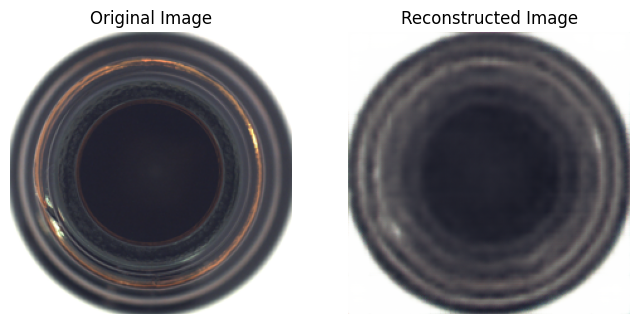

-------- epoch 100 --------


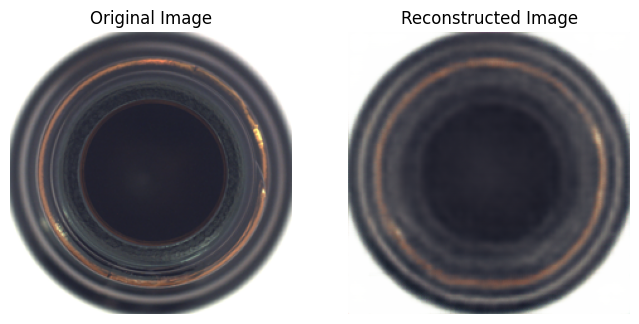

-------- epoch 150 --------


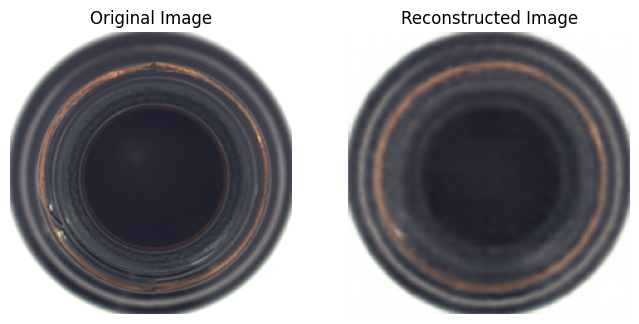

-------- epoch 200 --------


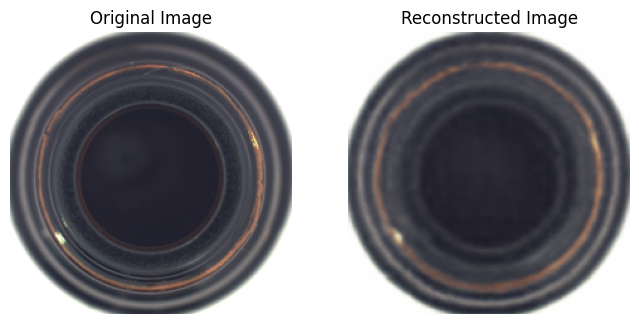

-------- epoch 250 --------


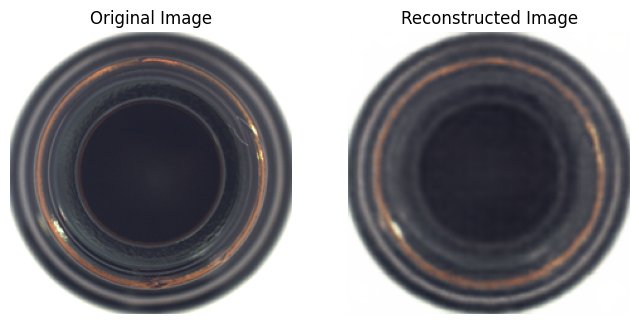

-------- epoch 300 --------


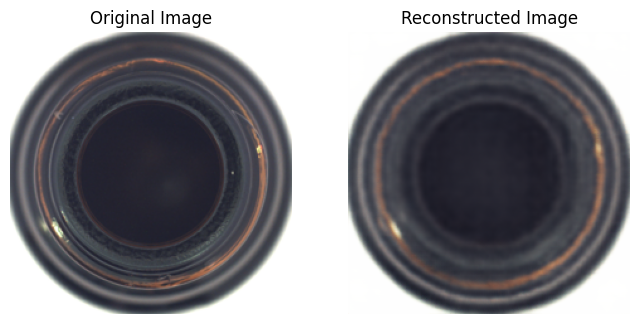

-------- epoch 350 --------


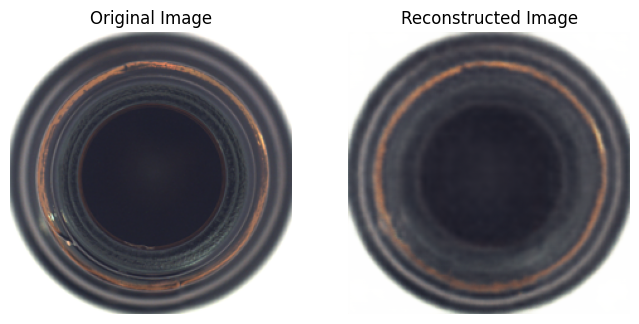

-------- epoch 400 --------


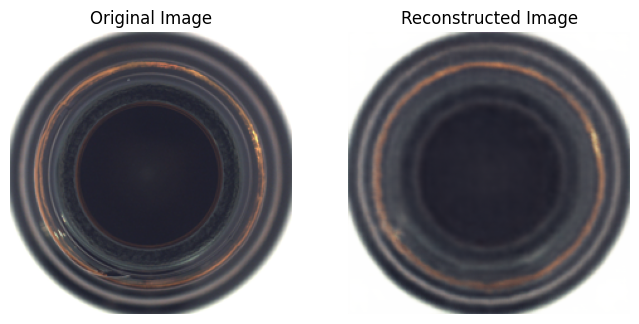

-------- epoch 450 --------


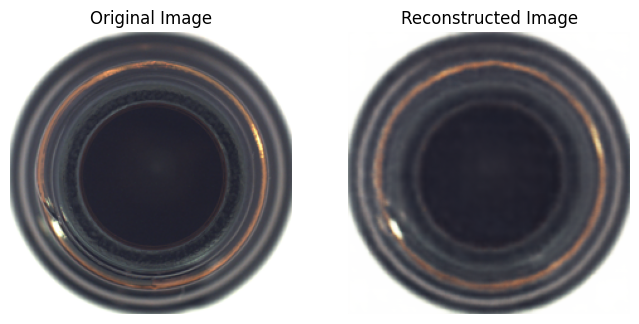

-------- epoch 500 --------


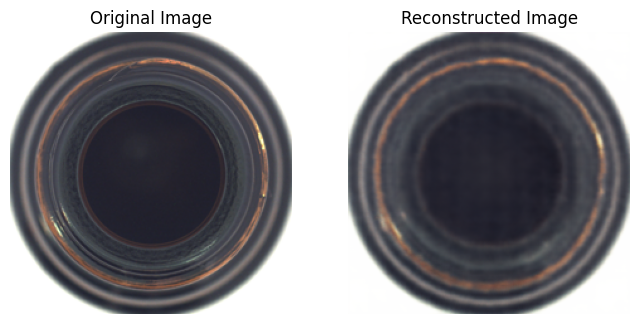

-------- epoch 550 --------


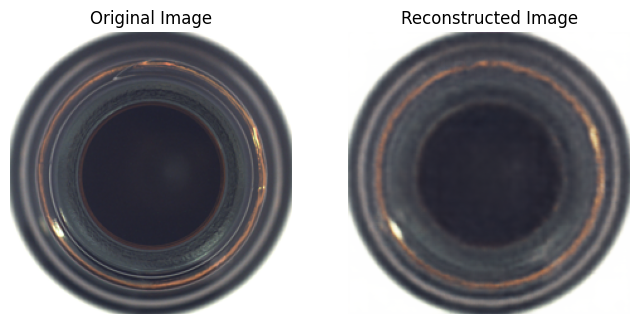

-------- epoch 600 --------


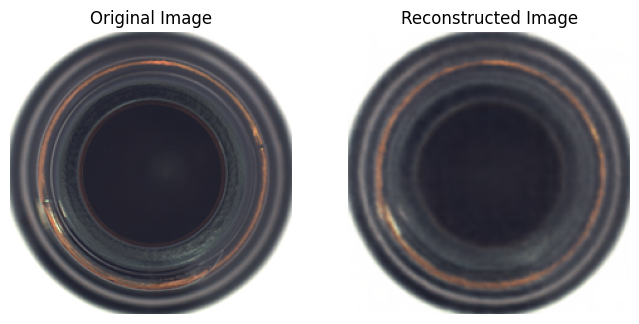

-------- epoch 650 --------


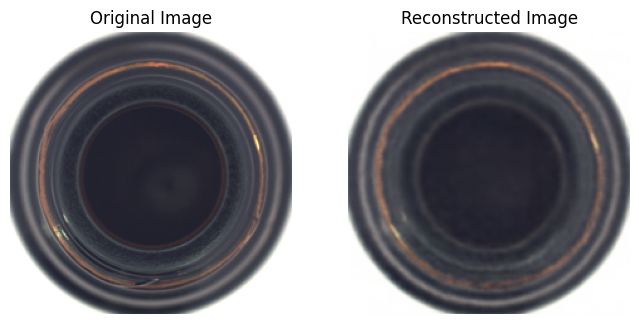

-------- epoch 700 --------


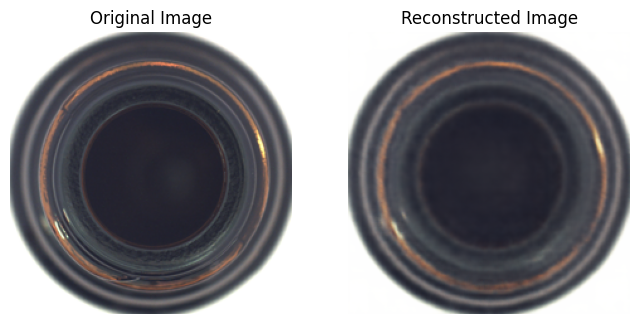

-------- epoch 750 --------


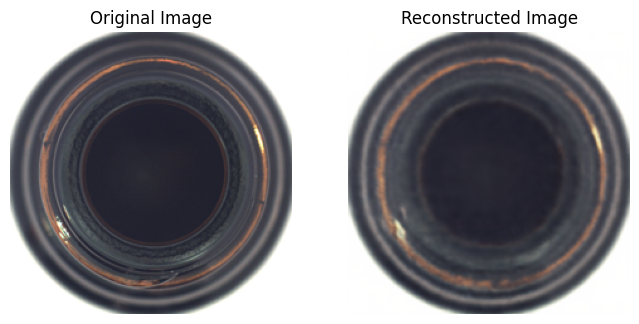

-------- epoch 800 --------


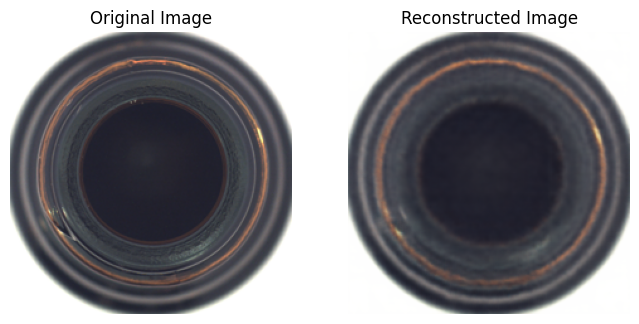

-------- epoch 850 --------


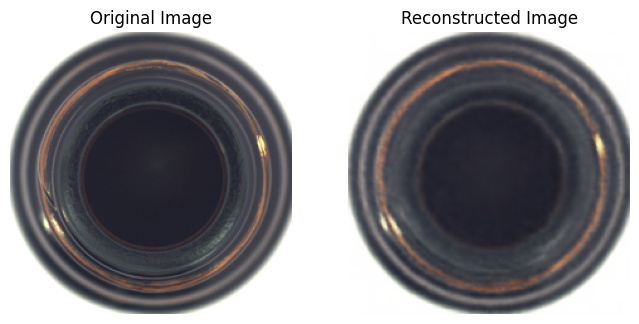

-------- epoch 900 --------


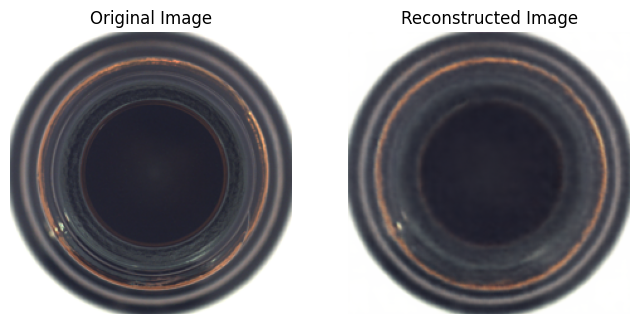

-------- epoch 950 --------


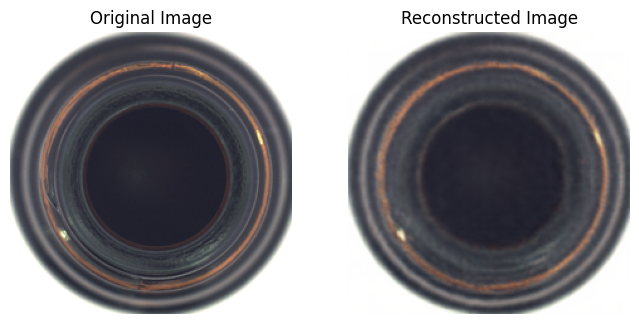

In [253]:
epoch = 50
for idx in range(19):

    print(f'-------- epoch {epoch} --------')
    epoch +=50
    for l in range(1):
        input_image = epoch_imgs[idx][0][0]
        reconstructed_image = epoch_imgs[idx][0][1]
    
        # 시각화
        plt.figure(figsize=(8, 4))
    
        # 원본 이미지
        plt.subplot(1, 2, 1)
        plt.title("Original Image")
        plt.imshow(input_image.permute(1, 2, 0).numpy())
        plt.axis("off")
    
        # 재구성 이미지
        plt.subplot(1, 2, 2)
        plt.title("Reconstructed Image")
        plt.imshow(reconstructed_image.permute(1, 2, 0).numpy())
        plt.axis("off")
        plt.show()

## anomaly map 확인

In [334]:
# def detect_anomalies_with_map(model, testloader, threshold=0.1):
#     model.eval()
#     anomaly_maps = []  # 이상 맵 저장
#     anomalies = []  # 이상 샘플 저장
#     reconstructed_image = []
#     with torch.no_grad():
#         # testloader에서 첫 번째 배치만 가져오기
#         inputs, _ = next(iter(testloader))  # 하나의 배치만 가져옵니다.
#         inputs = inputs.to(device)

#         # 재구성된 이미지 계산
#         reconstructed = model(inputs)

#         # Anomaly Map 생성 (입력 이미지와 재구성 이미지의 절대 오차)
#         anomaly_map = torch.pow(inputs - reconstructed,2)  # 픽셀 차이 계산
#         anomaly_map = anomaly_map.mean(dim=1, keepdim=True)  # 채널 평균

#         # Threshold 기준으로 이상 여부 판단
#         mse_loss = torch.mean((inputs - reconstructed) ** 2, dim=[1, 2, 3])  # 배치별 MSE
#         for idx, loss in enumerate(mse_loss):
#             if loss.item() > threshold:
#                 # 이상 샘플 저장
#                 anomalies.append(inputs[idx].cpu())  # 이상 샘플 저장
#                 reconstructed_image.append(reconstructed[idx].cpu())
#                 # 이상 맵을 임계값 기준으로 처리
#                 # 임계값을 넘는 부분은 1 (흰색), 아니면 0 (검은색)
#                 mask = (anomaly_map[idx].cpu().numpy() > threshold).astype(np.uint8)  # 흰색(1)과 검은색(0)으로 변환
#                 anomaly_maps.append(mask)  # 해당 맵 저장

#     return anomalies, anomaly_maps, reconstructed_image

# import matplotlib.pyplot as plt

from torch.nn.functional import cosine_similarity

def detect_anomalies_with_map(model, testloader, threshold=0.1):
    model.eval()
    anomaly_maps = []  # 이상 맵 저장
    anomalies = []  # 이상 샘플 저장
    labels = []
    reconstructed_image = []
    with torch.no_grad():
        # testloader에서 첫 번째 배치만 가져오기
        inputs, label = next(iter(testloader))  # 하나의 배치만 가져옵니다.
        inputs = inputs.to(device)

        # 재구성된 이미지 계산
        reconstructed = model(inputs)  # ReconstructionModel에서 반환된 값을 해체

        # Anomaly Map 생성 (코사인 거리 계산)
        anomaly_map = []
        for i in range(inputs.size(0)):
            # 각 픽셀에서 코사인 거리 계산
            input_flat = inputs[i].view(inputs.size(1), -1)  # (C, H*W)
            reconstructed_flat = reconstructed[i].view(reconstructed.size(1), -1)  # (C, H*W)
            cos_dist = 1 - cosine_similarity(input_flat, reconstructed_flat, dim=0)  # (H*W)
            cos_dist = cos_dist.view(inputs.size(2), inputs.size(3))  # (H, W)
            anomaly_map.append(cos_dist.cpu().numpy())
            
        # Threshold 기준으로 이상 여부 판단
        mse_loss = torch.mean((inputs - reconstructed) ** 2, dim=[1, 2, 3])  # 배치별 MSE
        for idx, loss in enumerate(mse_loss):
            if loss.item() > threshold:
                # 이상 샘플 저장
                anomalies.append(inputs[idx].cpu())  # 이상 샘플 저장
                reconstructed_image.append(reconstructed[idx].cpu())
                # 이상 맵을 임계값 기준으로 처리
                # 임계값을 넘는 부분은 1 (흰색), 아니면 0 (검은색)
                mask = (anomaly_map[idx] > threshold).astype(np.uint8)  # 흰색(1)과 검은색(0)으로 변환
                anomaly_maps.append(mask)  # 해당 맵 저장
                labels.append(label[idx])
    return anomalies, anomaly_maps, reconstructed_image, labels


def visualize_anomalies(model, testloader, threshold=0.1,num_images=5):
    """
    원본 이미지, 재구성 이미지, 이상 맵을 시각화하는 함수.

    Args:
        anomalies: 이상 이미지 리스트 (torch.Tensor 형태, shape: [C, H, W]).
        anomaly_maps: 이상 맵 리스트 (numpy.ndarray 형태, shape: [H, W]).
        reconstructed: 재구성된 이미지 (torch.Tensor 형태, shape: [C, H, W]).
        num_images: 시각화할 이미지 수.
    """
    anomalies, anomaly_maps, reconstructed, labels = detect_anomalies_with_map(model, testloader, threshold)
    # num_images 개의 이미지를 시각화합니다.
    for idx in range(min(num_images, len(anomalies))):
        input_image = anomalies[idx]
        reconstructed_image = reconstructed[idx].cpu()
        anomaly_map = anomaly_maps[idx]

        # 시각화
        plt.figure(figsize=(12, 6))

        # 원본 이미지
        plt.subplot(1, 3, 1)
        plt.title(f"Original Image {labels[idx]}")
        plt.imshow(input_image.permute(1, 2, 0).numpy())
        plt.axis("off")

        # 복 이미지
        plt.subplot(1, 3, 2)
        plt.title("Reconstructed Image")
        plt.imshow(reconstructed_image.permute(1, 2, 0).numpy())
        plt.axis("off")

        # anomaly map
        plt.subplot(1, 3, 3)
        plt.title("Anomaly Map")
        plt.imshow(anomaly_map, cmap="gray", interpolation="nearest")
        plt.axis("off")

        plt.show()


In [340]:
test_dataset.classes

['broken_large', 'broken_small', 'contamination', 'good']

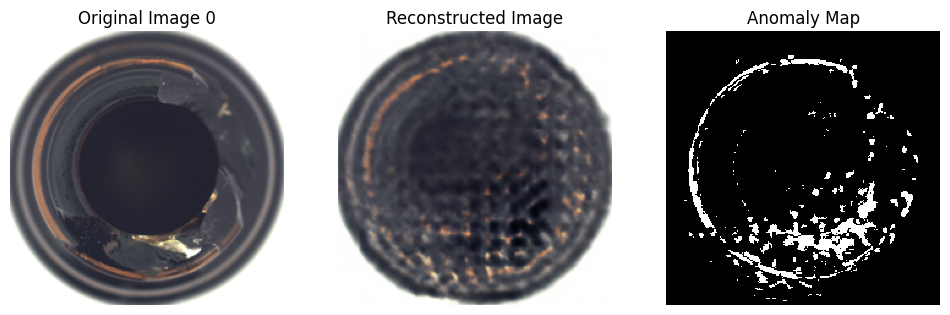

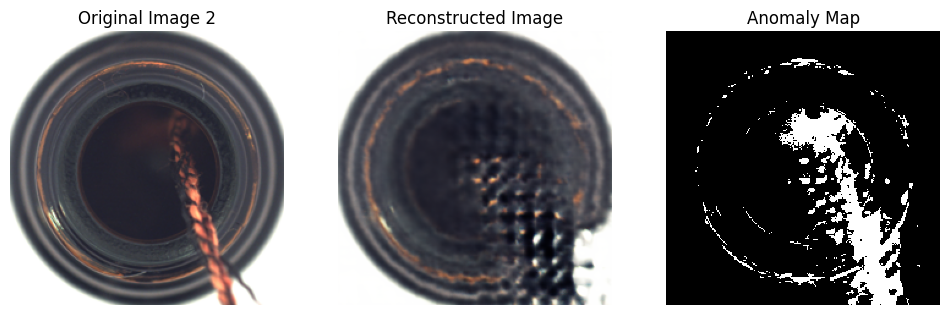

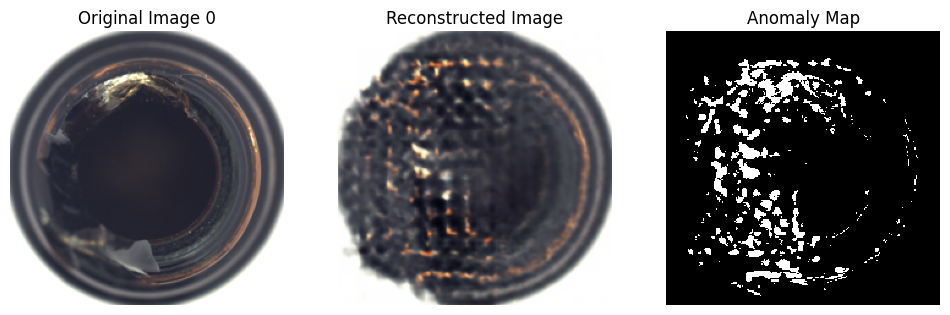

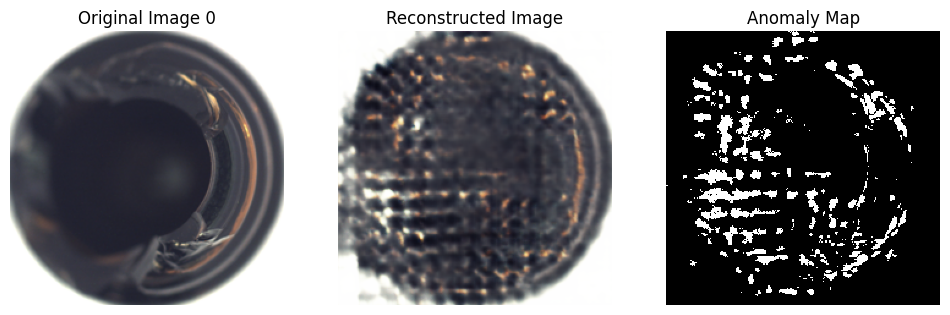

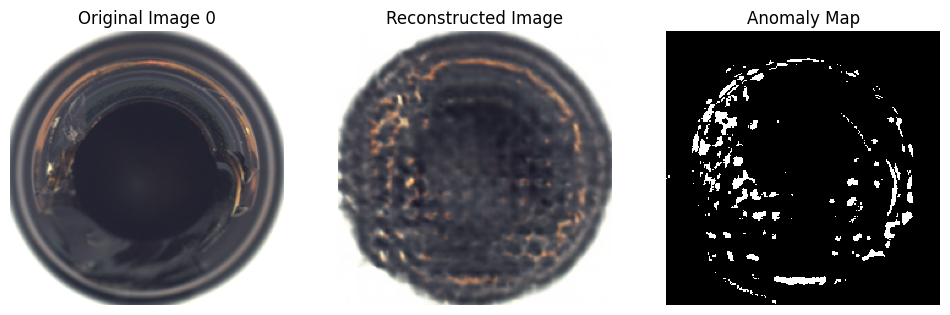

In [338]:
visualize_anomalies(model, testloader, threshold=0.01,num_images=5)

## 원본과 복원 이미지 확인

Original Images


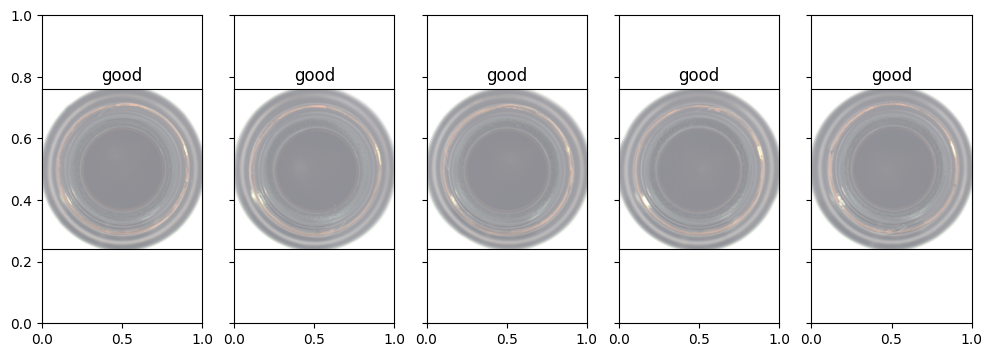

Reconstructed Images


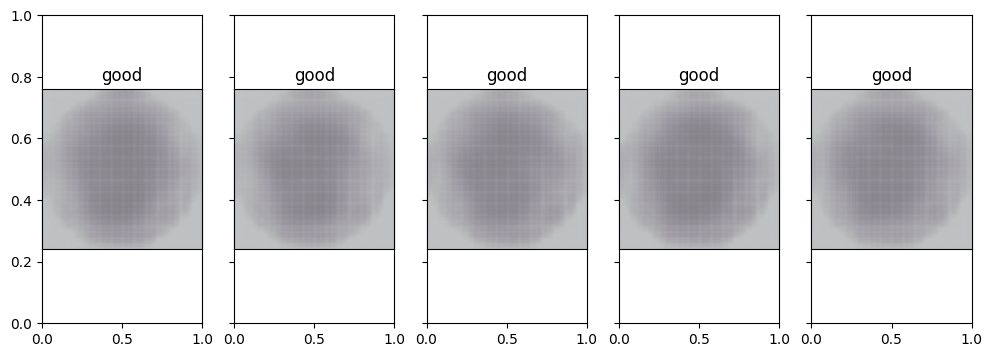

In [42]:
#Batch of test images
dataiter = iter(trainloader)
images, labels = next(dataiter)
images = images.to(device)
#Sample outputs
output = model(images)
images = images.cpu().numpy()

output = output.view(32, 3, 224, 224)
output = output.cpu().detach().numpy()

classes = transform_dataset.classes
#Original Images
print("Original Images")
fig, axes = plt.subplots(nrows=1, ncols=5, sharex=True, sharey=True, figsize=(12,4))
for idx in np.arange(5):
    ax = fig.add_subplot(1, 5, idx+1, xticks=[], yticks=[])
    imshow(images[idx])
    ax.set_title(classes[labels[idx]])
plt.show()
#Reconstructed Images
print('Reconstructed Images')
fig, axes = plt.subplots(nrows=1, ncols=5, sharex=True, sharey=True, figsize=(12,4))
for idx in np.arange(5):
    ax = fig.add_subplot(1, 5, idx+1, xticks=[], yticks=[])
    imshow(output[idx])
    ax.set_title(classes[labels[idx]])
plt.show()


## anomaly, anomlay map, reconstruction image확인

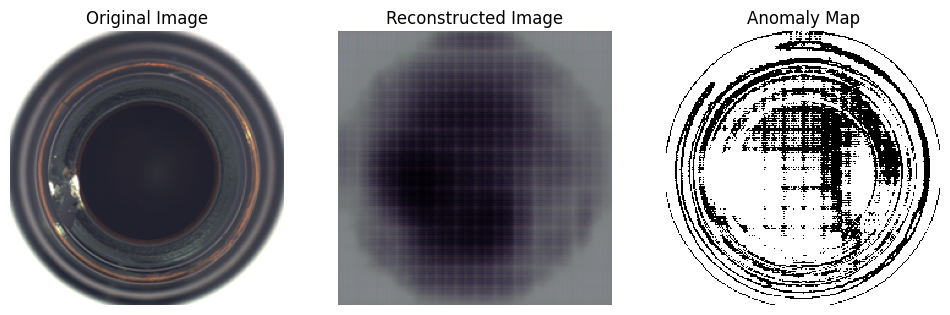

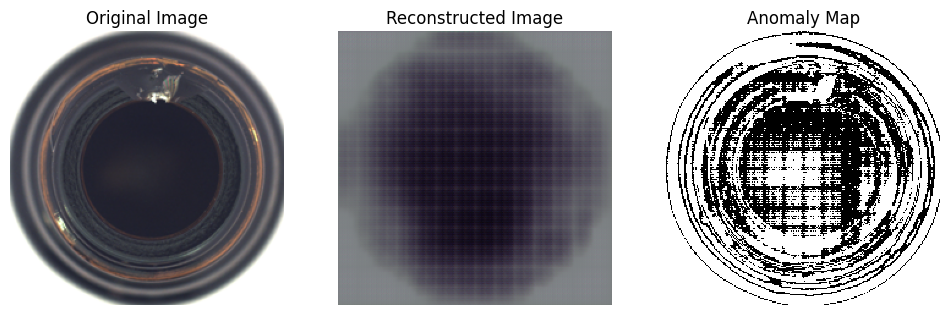

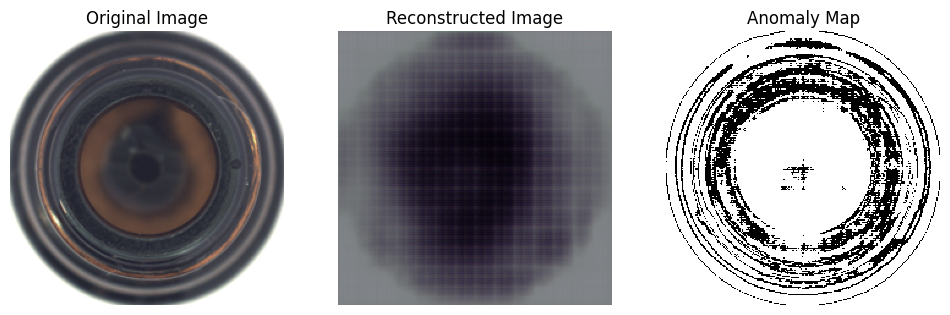

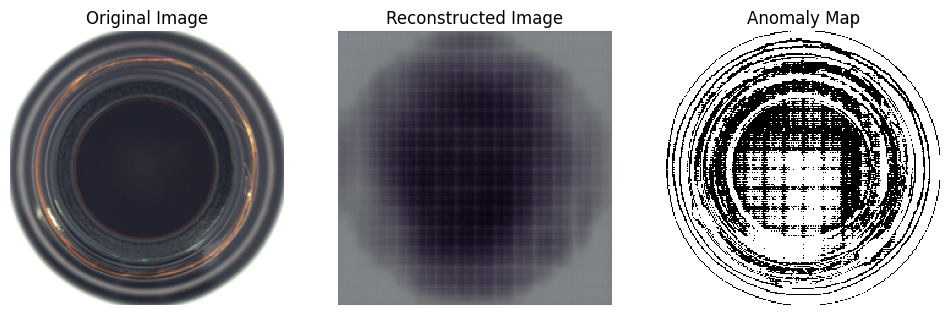

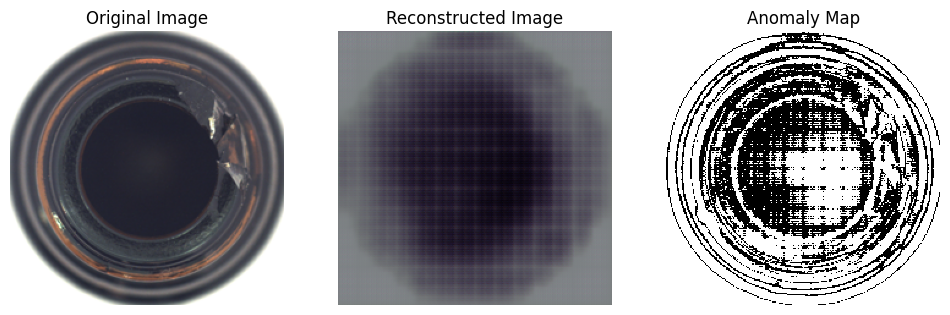

In [44]:
visualize_anomalies(model, testloader, threshold=0.05,num_images=5)

## Noisy Bottleneck

In [58]:
# VGG Encoder 정의
class VGGEncoder(nn.Module):
    def __init__(self):
        super(VGGEncoder, self).__init__()
        vgg = models.vgg16(pretrained=True)
        self.encoder = vgg.features  # VGG16의 features 부분 사용
        for param in self.encoder.parameters():
            param.requires_grad = False  # 가중치 업데이트 안 되도록 설정

    def forward(self, x):
        feature_maps = []  # 각 Conv 레이어의 feature map 저장
        for layer in self.encoder:
            x = layer(x)
            if isinstance(layer, nn.Conv2d):  # Conv 레이어일 경우만 저장
                feature_maps.append(x)
        return feature_maps

# Noisy Bottleneck구성
class NoisyBottleneck(nn.Module):
    def __init__(self):
        super(NoisyBottleneck, self).__init__()
        self.noisy_bottleneck = nn.Sequential(
            nn.Flatten(start_dim=1),
            nn.Linear(512 * 14 * 14, 4096),
            nn.GELU(),
            nn.Dropout(0.2),
            nn.Linear(4096, 512*14*14),
            nn.Unflatten(1,(512,7,7))
        )
    def forward(self, x):
        return self.noisy_bottleneck(x)
# Decoder 정의
class ReconstructionDecoder(nn.Module):
    def __init__(self):
        super(ReconstructionDecoder, self).__init__()
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()  # 0~1 범위로 정규화
        )

    def forward(self, x):
        return self.decoder(x)

# ReconstructionModel: VGGEncoder와 ReconstructionDecoder를 결합
class ReconstructionModel(nn.Module):
    def __init__(self):
        super(ReconstructionModel, self).__init__()
        self.encoder = VGGEncoder()
        self.noisy_bottleneck = NoisyBottleneck()
        self.decoder = ReconstructionDecoder()

    def forward(self, x):
        feature_maps = self.encoder(x)  # Encoder로부터 feature map 얻기
        encoded = feature_maps[-1]     # 마지막 feature map 사용
        noisy = self.noisy_bottleneck(encoded)
        reconstructed = self.decoder(noisy)
        return reconstructed, feature_maps  # 재구성된 이미지와 feature map을 반환

class AnomalyDetectionModel(nn.Module):
    def __init__(self):
        super(AnomalyDetectionModel, self).__init__()
        self.reconstruction_model = ReconstructionModel()

    def forward(self, x):
        reconstructed, _ = self.reconstruction_model(x)
        return reconstructed

    def calculate_loss(self, x, reconstructed):
        # MSE Loss로 재구성 손실 계산
        loss = nn.MSELoss()(reconstructed, x)
        return loss

### train

In [348]:
import torch
torch.cuda.empty_cache()

In [ ]:
!pip install numba

from numba import cuda

In [65]:
device = cuda.get_current_device(); device.reset()

AttributeError: module 'torch.cuda' has no attribute 'get_current_device'

In [61]:
# 학습 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = AnomalyDetectionModel().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
# 모델 학습
train_model(model, trainloader, optimizer, num_epochs=3)

OutOfMemoryError: CUDA out of memory. Tried to allocate 1.53 GiB. GPU 0 has a total capacity of 14.75 GiB of which 153.06 MiB is free. Process 2398 has 14.60 GiB memory in use. Of the allocated memory 14.28 GiB is allocated by PyTorch, and 201.76 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

## Loose constraint

In [342]:
# VGG Encoder 정의
class VGGEncoder(nn.Module):
    def __init__(self):
        super(VGGEncoder, self).__init__()
        vgg = models.vgg16(pretrained=True)
        self.encoder = vgg.features  # VGG16의 features 부분 사용
        for param in self.encoder.parameters():
            param.requires_grad = False  # 가중치 업데이트 안 되도록 설정

    def forward(self, x):
        feature_maps = []  # 각 Conv 레이어의 feature map 저장
        for layer in self.encoder:
            x = layer(x)
            if isinstance(layer, nn.Conv2d):  # Conv 레이어일 경우만 저장
                feature_maps.append(x)
        return feature_maps

# Noisy Bottleneck구성
class NoisyBottleneck(nn.Module):
    def __init__(self):
        super(NoisyBottleneck, self).__init__()
        self.noisy_bottleneck = nn.Sequential(
            nn.Flatten(start_dim=1),
            nn.Linear(512 * 14 * 14, 4096),
            nn.GELU(),
            nn.Dropout(0.2),
            nn.Linear(4096, 512*14*14),
            nn.Unflatten(1,(512,14,14))
        )
    def forward(self, x):
        return self.noisy_bottleneck(x)
# Decoder 정의
class ReconstructionDecoder(nn.Module):
    def __init__(self):
        super(ReconstructionDecoder, self).__init__()
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()  # 0~1 범위로 정규화
        )
        self.transconv_featuremaps = []

    def forward(self, x):
        self.transconv_featuremaps.clear()
        for layer in self.decoder:
            x = layer(x)
            if isinstance(layer, nn.ConvTranspose2d):
                self.transconv_featuremaps.append(x)
                
        return self.transconv_featuremaps 

# ReconstructionModel: VGGEncoder와 ReconstructionDecoder를 결합
class ReconstructionModel(nn.Module):
    def __init__(self):
        super(ReconstructionModel, self).__init__()
        self.encoder = VGGEncoder()
        self.noisy_bottleneck = NoisyBottleneck()
        self.decoder = ReconstructionDecoder()

    def forward(self, x):
        feature_maps = self.encoder(x)  # Encoder로부터 feature map 얻기
        encoded = feature_maps[-1]     # 마지막 feature map 사용
        noisy = self.noisy_bottleneck(encoded)
        decoder_features = self.decoder(noisy)
        reconstructed = decoder_features[-1]
        return reconstructed, feature_maps, decoder_features  # 재구성된 이미지와 feature map을 반환

class AnomalyDetectionModel(nn.Module):
    def __init__(self):
        super(AnomalyDetectionModel, self).__init__()
        self.reconstruction_model = ReconstructionModel()
        #1x1 conv
        # group a
        self.channel_adjust_a_enc_64 = nn.Conv2d(128, 256, kernel_size=1)
        self.channel_adjust_a_dec_3 = nn.Conv2d(3, 256, kernel_size=1)
        self.channel_adjust_a_dec_32 = nn.Conv2d(32, 256, kernel_size=1)
        self.channel_adjust_a_dec_64 = nn.Conv2d(64, 256, kernel_size=1)

        # group b
        self.channel_adjust_b_dec_128 = nn.Conv2d(256, 512, kernel_size=1)
        self.channel_adjust_b_dec_256 = nn.Conv2d(128, 512, kernel_size=1)

    def forward(self, x):
        reconstructed, feature_maps, decoder_features = self.reconstruction_model(x)
        return reconstructed, feature_maps, decoder_features

    def calculate_loss(self, x, reconstructed, feature_maps, decoder_features):
        # MSE Loss로 재구성 손실 계산
        group_a_enc = feature_maps[2:7]
        group_a_dec = decoder_features[-3:]
        group_b_enc = feature_maps[-6:]
        group_b_dec = decoder_features[:2]

        # upsampling
        group_a_enc_resized = [F.interpolate(fm, (112,112), mode='bicubic', align_corners=False) for fm in group_a_enc]
        group_a_dec_resized = [F.interpolate(fm, (112,112), mode='bicubic', align_corners=False) for fm in group_a_dec]
        group_b_enc_resized = [F.interpolate(fm, (28,28), mode='bicubic', align_corners=False) for fm in group_b_enc]
        group_b_dec_resized = [F.interpolate(fm, (28,28), mode='bicubic', align_corners=False) for fm in group_b_dec]

        # 채널수 맞추기
        group_a_enc_resized[0] = self.channel_adjust_a_enc_64(group_a_enc_resized[0])
        group_a_enc_resized[1] = self.channel_adjust_a_enc_64(group_a_enc_resized[1])

        group_a_dec_resized[-1] = self.channel_adjust_a_dec_3(group_a_dec_resized[-1])
        group_a_dec_resized[-2] = self.channel_adjust_a_dec_32(group_a_dec_resized[-2])
        group_a_dec_resized[-3] = self.channel_adjust_a_dec_64(group_a_dec_resized[-3])

        group_b_dec_resized[0] = self.channel_adjust_b_dec_128(group_b_dec_resized[0])
        group_b_dec_resized[1] = self.channel_adjust_b_dec_256(group_b_dec_resized[1])

        group_a_loss = nn.MSELoss()(sum(group_a_enc_resized), sum(group_a_dec_resized))
        group_b_loss = nn.MSELoss()(sum(group_b_enc_resized), sum(group_b_dec_resized))
        loss = (group_a_loss + group_b_loss)/2
        return loss

In [344]:
# 학습 루프
def train_model(model, dataloader, optimizer, num_epochs=10):
    model.train()
    for epoch in range(num_epochs):
        running_loss = 0.0
        for inputs, _ in dataloader:
            inputs = inputs.to(device)

            optimizer.zero_grad()

            # 재구성된 이미지 계산
            reconstructed, enc_featuremaps, dec_featuremaps = model(inputs)  # _ 대신 feature_maps는 필요 없을 경우 제거

            # 손실 계산
            loss = model.calculate_loss(inputs, reconstructed, enc_featuremaps, dec_featuremaps)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)

        epoch_loss = running_loss / len(dataloader.dataset)
        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")


In [350]:
# 학습 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = AnomalyDetectionModel().to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)

# 모델 학습
train_model(model, trainloader, optimizer, num_epochs=3)

OutOfMemoryError: CUDA out of memory. Tried to allocate 1.53 GiB. GPU 0 has a total capacity of 8.00 GiB of which 0 bytes is free. Of the allocated memory 17.73 GiB is allocated by PyTorch, and 92.33 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

## Loose Loss